# DSFB Assignment 1

In this assignment, you will work with data, examine distributions of some variables, and make some simple predictions. These basic operations are important in any data science project. 

[Pandas](https://pandas.pydata.org/) is a Python package built for data analysis. It includes many useful functions, including one to read comma-separated (.csv) files. We will use this package as it's both easy to use and very powerful.

First, we need to import Pandas. As you will be learning (or already know), popular Python packages have common abbreviates. These abbreviations are used as a short-hand for that package throughout a Python script. Some of these common abbreviations include:

- `import pandas as pd`
- `import numpy as np`
- `import tensorflow as tf`
- etc.

Second, we can call any function in the Pandas package as `pd.someFunction`. The `pd` keyword is reserved for Pandas and must not be used by any other variable. 

Third, `import` statements are generally located at the top of a script, even though they might only be used at a later stage.

Finally, do not hesitate to search the [Pandas documentation](https://pandas.pydata.org/pandas-docs/stable/) for help.


In [1]:
import os

from math import log
 
import numpy as np    
import pandas as pd


from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression


import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns

from scipy.stats import lognorm
from scipy.stats import gamma
from scipy.stats import beta
from scipy.special import expit

# PART 1: WORK WITH A TAB-SEPARATED TEXT FILE

In this section, you will load in a plain text file where columns have been separated by a tab character. The tab character is represented in code as the: `\t` symbol.   

Tab separated data is typical for government data or legacy data coming out of old mainframe systems.  

We will us data from the US Patent Office (USPTO). The file contains two columns:

- id: patent sub-class id
- title: patent sub-class title

**PROBLEM**: Open and read in the `USPTOsubclasses.txt` file using the native Python `open()` command.

In [666]:
# open the .txt file
data_folder='Data/'
file=open(data_folder+"USPTOsubclasses.txt")
USPTOsubclasses=file.read()
#print(USPTOsubclasses)


**PROBLEM**: Make a list of lists. First, split the data by line, and the split it again by column. 

In [667]:
# split the raw text by the new line character "\n" )
data_USPTOsubclasses = (str(USPTOsubclasses).split("\n"))


In [668]:
# create a "list of lists" 
#   each entry in the "outer" list is a row from the file; 
#   each row can be split into an "inner" list of tab-separated columns
list_of_lists = []
for line in data_USPTOsubclasses:
    stripped_line = line.split("\t")
    list_of_lists.append(stripped_line)




In [669]:
# what's the sub-class "1/1" called?  hint: look at first 10 elements of your list... 
#Unclassified

for line in list_of_lists:
    print(line)


['id', 'title']
['-0T/74', 'NULL']
['01L/294.8', 'NULL']
['01L/298.8', 'NULL']
['01L/299.0', 'NULL']
['1/1', 'Unclassified']
['100/1', 'BINDING']
['100/10', 'With precutting of binder to length']
['100/10.*1', 'WITH ADDITIONAL TREATMENT OF MATERIAL (100/70 R)']
['100/100', 'WITH GROUND']
['100/100.**2', 'Heating, cooling, or drying (100/92)']
['100/101', 'WITH CLOTH ABOUT CAKE ENFOLDER']
['100/102', 'COMBINED']
['100/103', 'CONVERTIBLE']
['100/104', 'WITH DRAIN MEANS FOR EXPRESSED LIQUID']
['100/105', 'Plural liquids (peel oil)']
['100/106', 'Liquid impelling means']
['100/107', 'Drain tube inbedded in material']
['100/108', 'With piercing point or edge']
['100/109', 'Stacked boxes or plates']
['100/11', 'Plural flexible section binder']
['100/110', 'Drainage through or along pressure surface']
['100/111', 'With valve or adjustable flow regulator']
['100/112', 'With clearer or cleaner']
['100/113', 'Stacked boxes or plates']
['100/114', 'Flexibly connected']
['100/115', 'Boxes or plate

['106/14.33', 'Inorganic material or elemental component thereof, e.g., S, metal, etc']
['106/14.34', 'Contains wax, bitumen, asphalt, gum, natural resin, varnish, lacquer, or paint']
['106/14.35', 'Caboxylic acid, ester, alcohol or sulfur or metal derivative']
['106/14.36', 'Metal salt of carboxylic acid']
['106/14.37', 'Organic nitrogen']
['106/14.38', 'Organic sulfur']
['106/14.39', 'Inorganic material or elemental component thereof']
['106/14.41', 'Contains mixture of at least two organic compounds']
['106/14.42', 'Organic nitrogen']
['106/14.43', 'Organic sulfur']
['106/14.44', 'Contains mixture of organic material and at least one inorganic material or elemental component thereof']
['106/14.45', 'Elemental S or inorganic sulfur']
['106/14.5', 'Hectographic or copying']
['106/140.1', 'Cellulose ether or salt thereof']
['106/140.2', 'With natural resin or derivative']
['106/140.3', 'With nonproteinaceous organic compound containing oxygen except wax']
['106/140.5', 'NULL']
['106/14

['114/336', 'Emergency equipment']
['114/337', 'Having propulsion unit']
['114/338', 'Propeller']
['114/339', 'Superstructure']
['114/34', 'Conveyors']
['114/340', 'With periscope']
['114/341', 'Hulls with transverse reinforcement']
['114/342', 'Hull within a hull']
['114/343', 'BOATS, BOAT COMPONENT, OR ATTACHMENT']
['114/344', 'With wheeled buoyant landing or launching aid']
['114/345', 'Inflatable']
['114/346', 'Circular']
['114/347', 'Canoe or kayak']
['114/348', 'Lifeboat']
['114/349', 'Enclosed']
['114/35', 'Side doors']
['114/350', 'With self']
['114/351', 'Hunting']
['114/352', 'Sectional']
['114/353', 'With folding']
['114/354', 'Collapsible']
['114/355', 'Hull construction']
['114/356', 'Metal']
['114/357', 'Plastic']
['114/358', 'Wood']
['114/359', 'Former and framer']
['114/36', 'Bottom doors']
['114/360', 'With means to prevent capsizing or sinking']
['114/361', 'Protective cover or shield']
['114/362', 'Boarding aids']
['114/363', 'Seat and foot support']
['114/364', 'Dec

['122/490', 'For tilting boilers']
['122/491', 'Interior of boilers']
['122/492', 'Steam dome']
['122/493', 'BRACES AND STAYS']
['122/494', 'CASINGS']
['122/495', 'CROWN SHEETS PROTECTING']
['122/496', 'CROWN SHEETS AND STAYS']
['122/497', 'FRONTS']
['122/498', 'Doors']
['122/499', 'Mouths']
['122/4A', 'Electric boiler']
['122/4C', 'Water']
['122/4D', 'Catalyst']
['122/4R', 'MISCELLANEOUS']
['122/5', 'GAS']
['122/5.51', 'AIR']
['122/5.52', 'Combustion gas and vapor contact']
['122/50', 'Flue']
['122/50.**1', 'Water firebox']
['122/50.**2', 'Horizontal or inclined']
['122/500', 'Water firebox']
['122/501', 'FLUID']
['122/502', 'Fluid fuel']
['122/503', 'FUEL BAFFLES']
['122/504', 'SAFETY DEVICES']
['122/504.1', 'Fusible control']
['122/504.2', 'Alarms or indicators']
['122/504.3', 'Fusible control']
['122/504.3*1', 'Fire extinguishers']
['122/505', 'Float']
['122/506', 'Pressure']
['122/507', 'Self']
['122/508', 'STEAM DOMES']
['122/509', 'SUBMERGED STEAM CHAMBER']
['122/51', 'Horizonta

['131/288', 'By liquid means']
['131/289', 'By scraping, wiping, etc']
['131/29', 'With tip or mouthpiece applier or former']
['131/290', 'TOBACCO TREATMENT']
['131/291', 'Puffing']
['131/292', 'Including freeze drying']
['131/293', 'By chemical reaction']
['131/294', 'By radiant energy']
['131/295', 'By high frequency field']
['131/296', 'By contact with hot gaseous medium']
['131/297', 'Extraction of component, other than moisture, by contact with diverse medium']
['131/298', 'By organic solvent']
['131/299', 'With electrical or radiant energy']
['131/30', 'With stationary smoother']
['131/300', 'With fluid or fluent material']
['131/301', 'Including means to create a vacuum']
['131/302', 'Including means to circulate fluid']
['131/303', 'And temperature or humidity control of fluid']
['131/304', 'Including means to convey tobacco']
['131/305', 'Within rotary drum']
['131/306', 'Including means to convey tobacco']
['131/307', 'Including expressing rolls']
['131/308', 'Containing enzy

['139/59', 'Jacquard']
['139/6', 'Portable supply']
['139/60', 'Knotted cord']
['139/61', 'Multiple cylinder']
['139/62', 'Group control']
['139/63', 'Locked open shed']
['139/64', 'Mid closing']
['139/65', 'Double lift']
['139/66A', 'Dobby loom details']
['139/66R', 'Dobby']
['139/67', 'Vibrating griff']
['139/68', 'Jacquard pattern']
['139/69', 'Mid closing']
['139/70', 'Curved motion']
['139/71', 'Double lift']
['139/72', 'Locked open shed']
['139/73', 'Irreversible transmission']
['139/74', 'Evener direct']
['139/75', 'Harness levelers']
['139/76', 'Rotating actuator']
['139/77', 'Vibrator gear']
['139/78', 'Pattern direct']
['139/79', 'Cam']
['139/7A', 'Tuft yarn carrier']
['139/7B', 'Carrier chain mechanism']
['139/7C', 'Transfer device']
['139/7D', 'Gripper means']
['139/7E', 'Tuft forming means']
['139/7F', 'Cutter means']
['139/7G', 'Tube brake means']
['139/7R', 'Portable supply']
['139/8', 'Including tuft presenting']
['139/80', 'With varying means']
['139/81', 'Double actin

['15/234', 'Feather']
['15/235', 'Pelts']
['15/235.3', 'Mortar']
['15/235.4', "Mason's trowel or float"]
['15/235.5', 'Darby type']
['15/235.6', 'Undulated']
['15/235.7', 'Corner type']
['15/235.8', 'Adjustable']
['15/236.07', 'NULL']
['15/236.08', 'NULL']
['15/236.1', 'Rotary']
['15/236.2', 'Windshield']
['15/236.3', 'Paint roller']
['15/236.4', 'Gutter']
['15/236.5', 'Plural bladed']
['15/236.6', 'Simultaneously useable']
['15/236.7', 'Arcuate scraping edge']
['15/236.8', 'Toothed or serrated']
['15/236.9', 'For plural surfaces']
['15/237', 'Boot cleaners']
['15/238', 'Mats']
['15/239', 'Pivoted link']
['15/24', 'Fountain']
['15/240', 'Filler block']
['15/241', 'Wire']
['15/244.1', 'Sponge or sponge with holder']
['15/244.2', 'Having pivoted handle']
['15/244.3', 'Having fabric cover or back']
['15/244.4', 'Sponge']
['15/245', 'Squeegee']
['15/245.1', 'Bladed spreader']
['15/246', 'ATTACHMENTS']
['15/246.2', 'For a vacuum cleaner']
['15/246.3', 'With treating means (e.g., deodorizing

['160/178.2', 'Cord lock']
['160/178.3', 'Slat support (e.g., tape ladder)']
['160/179', 'Plural fabrics in a single frame']
['160/180', 'One closing opening in another']
['160/181', 'With mounting or supporting means']
['160/182', 'Removable frame']
['160/183', 'Nonplanar nonparallel arrangement on support']
['160/184', 'Strip, slat, or panel not interconnected for relative motion']
['160/185', 'Strip, slat, or panel interconnected for diverse relative motions']
['160/186', 'Arranged to provide plural passageways on opening']
['160/187', 'Strip, slat, or panel pivotally interconnected']
['160/188', 'With operating means']
['160/189', 'Counterbalance and additional operator']
['160/19', 'WITH HOOD, CANOPY, SHIELD STORAGE CHAMBER, OR OUTRIGGED RIGID PANEL']
['160/190', 'Counterbalance only']
['160/191', 'Spring']
['160/192', 'Spring']
['160/193', 'Strand']
['160/194', 'Movably mounted track']
['160/195', 'Pivotally mounted']
['160/196.1', 'Unit hung from horizontal track']
['160/197', '

['169/89', 'Discharge head']
['169/9', 'Gas']
['169/90', 'Shut off valve']
['169/91', 'MISCELLANEOUS: E.G., BLOWERS']
['169/DIG1', 'Floats']
['169/DIG2', 'Ablative fluids']
['169/DIG3', 'Trip mechanisms']
['169/FOR', 'CLASS']
['169/FOR.**', 'FOREIGN ART COLLECTIONS']
['169/FOR.***', '**********************************']
['169/FOR*', '**********************************']
['17/11', 'NULL']
['17/1G', 'NULL']
['17/46', 'NULL']
['171/1', 'METHODS OF RECOVERING BURIED OBJECTS']
['171/10', 'WITH PRELIMINARY REMOVAL OR UNDESIRED EARTH MATERIAL']
['171/100', 'Pivoted about ground wheel axle']
['171/101', 'Separating digger intercepted by moving conveyer or impeller']
['171/102', 'Laterally deflecting diggers']
['171/103', 'Spaced, inclined shares or guides (pairs)']
['171/104', 'Inclined lifting surfaces']
['171/105', 'Tines (e.g., forks)']
['171/106', 'Vertically stepped transverse elements']
['171/107', 'Tooth or tine arrangements or details']
['171/108', 'TRACTION WHEEL DRIVE DETAILS FOR UNE

['177/179', 'WITH BEARING SHIELD']
['177/18', 'Cycle totalizer']
['177/180', 'WITH CASING CLOSURE OR SHIELD']
['177/181', 'Transparent']
['177/182', 'Lens']
['177/183', 'LUBRICATOR']
['177/184', 'SHOCK ABSORBER, DAMPER']
['177/185', 'Electrical or magnetic']
['177/186', 'Indicator mechanism']
['177/187', 'Load']
['177/188', 'Fulcrumed lever']
['177/189', 'Load holder']
['177/19', 'Single totalizer operated by plural weighers']
['177/190', 'EQUAL ARM TYPE']
['177/191', 'With counterweight manipulating means']
['177/192', 'Elongated flexible counterweight']
['177/193', 'With indicator tower']
['177/194', 'With bias toward balance']
['177/195', 'By spring']
['177/196', 'Torsion bearing type']
['177/197', 'With longitudinally movable poise']
['177/198', 'With check link']
['177/199', 'PLURAL DISTINCT LOAD HOLDERS WITH COMMON EVALUATOR']
['177/2', 'WITH RECORDER']
['177/20', 'By preliminary translation of rotary weighers']
['177/200', 'Load comparing type']
['177/201', 'SELF']
['177/202', '

['186/56', 'Machine readable']
['186/57', 'Relatively movable selection station and merchandise shelving']
['186/58', 'With order carrier movable on track means']
['186/59', 'Checkout counter']
['186/6', 'Pivoted arms']
['186/60', 'With conveyor to vehicle loading station']
['186/61', 'With means enabling price reading']
['186/62', 'With cart accommodation or handling']
['186/63', 'Cart emptying facilitation']
['186/64', 'Self']
['186/65', 'With elevating means']
['186/66', 'With bag storage or bagging support']
['186/67', 'With turntable']
['186/68', 'With power driven belt conveyor']
['186/69', 'With power driven conveyor']
['186/7', 'Self']
['186/8', 'Single']
['186/9', 'Speed increasing']
['186/FOR', 'CLASS']
['186/FOR.**', 'FOREIGN ART COLLECTIONS']
['186/FOR.***', '**********************************']
['186/FOR*', '**********************************']
['187/1R', 'NULL']
['187/200', 'STAIRWAY ASSIST FOR INDIVIDUAL OR MINOR BARRIER (E.G., CURB) LIFT FOR IMPAIRED INDIVIDUAL']
['187/

['194/226', 'Having ratchet wheel']
['194/227', 'And indexing means differently responsive to various check values']
['194/228', 'And means to impart thrust to check to operate accumulator']
['194/229', 'CONTROL MECHANISM RESPONSIVE TO PLURALITY OF CHECKS']
['194/230', 'Including electric circuit with switch operated by check']
['194/231', 'Single switch']
['194/232', 'Including part locked by detent and released by check']
['194/233', 'Stationary detent']
['194/234', 'And means to impart thrust to check to unlock part']
['194/235', 'Pivoted detent']
['194/236', 'And pivoted released part']
['194/237', 'Check prevents locking of part by detent']
['194/238', 'Including reciprocating check mover']
['194/239', 'INCLUDING ELECTRIC CIRCUIT WITH SWITCH OPERATED BY CHECK']
['194/240', 'And holding circuit responsive to operation of switch']
['194/241', 'Controlled by timer']
['194/242', 'Weight of check operates switch']
['194/243', 'And means to impart thrust to check to operate switch']
['1

['203/10', 'WATER PURIFICATION ONLY']
['203/100', 'PARTICULAR TYPE OF HEATING']
['203/11', 'Under pressure or vacuum']
['203/12', 'DISTILLING TO SEPARATE OR REMOVE ONLY WATER']
['203/12.**', 'CROSS']
['203/12.***', '******************************']
['203/12*', '******************************']
['203/13', 'From nitric acid']
['203/13.**', 'DIGESTS']
['203/13.***', '******************************']
['203/13*', '******************************']
['203/14', 'From organic compound']
['203/15', 'Organic acid']
['203/16', 'Acetic']
['203/17', 'Aldehyde or ketone']
['203/18', 'Alcohol']
['203/19', 'Ethanol']
['203/2', 'Of temperature or pressure']
['203/20', 'INCLUDING DEFOAMING OR INHIBITING FOAM']
['203/21', 'AND RECOVERING HEAT BY INDIRECT HEAT EXCHANGE']
['203/22', 'Utilizing recovered heat for heating feed']
['203/23', 'Distillation residue as heat source']
['203/24', 'Compressed vapor as heat source']
['203/25', 'Utilizing recovered heat for heating the distillation zone']
['203/26', 'Com

['209/176', 'With chemical treatment']
['209/177', 'Bath']
['209/178', 'Ore']
['209/179', 'With electric treatment']
['209/18', 'Aqueous suspension and stratifying']
['209/180', 'Bath']
['209/181', 'Ore']
['209/182', 'With heat treatment']
['209/183', 'Submerging']
['209/183.**1', 'Feeding and distributing']
['209/184', 'Conveyor']
['209/185', 'Vacuum']
['209/186', 'With agitation']
['209/187', 'Baffles']
['209/188', 'Agitators']
['209/189', 'Surface']
['209/19', 'Gaseous suspension, sifting, and stratifying']
['209/190', 'Impact']
['209/191', 'With rubbing']
['209/192', 'Feeding and discharging']
['209/193', 'Bath']
['209/194', 'Receptacles']
['209/195', 'Reciprocating']
['209/196', 'Chutes and tables']
['209/197', 'With agitators']
['209/198', 'Rotating']
['209/199', 'Centrifugal']
['209/2', 'SPECIAL APPLICATIONS']
['209/20', 'Gaseous suspension and stratifying']
['209/200', 'With agitators']
['209/201', 'Stationary']
['209/202', 'Chutes and tables']
['209/203', 'With agitators']
['2

['215/255', 'With nonintegral actuator (e.g., attached pull ring)']
['215/256', 'Line of weakness extends circumferentially of receptacle mouth opening']
['215/257', 'With cutting or tearing means (e.g., wire or string rip cord)']
['215/258', 'Closure removal causes portion thereof to remain with receptacle']
['215/259', 'Gas passes through a liquid']
['215/26', 'Guards']
['215/260', 'With pressure']
['215/261', 'Barrier permeable to gas and impermeable to liquid']
['215/262', 'With vacuum breaker']
['215/263', 'Nonresealable, nonremovable closure']
['215/264', 'Applied from within receptacle']
['215/265', 'Plural closures']
['215/266', 'Ball type']
['215/267', 'With manipulator']
['215/268', 'Wire']
['215/269', 'Having an inflatable member']
['215/27', 'Integral with the container']
['215/270', 'With pressure']
['215/271', 'Closure expands responsive to internal receptacle pressure']
['215/272', 'Cap type with manually actuated means to contract depending skirt part']
['215/273', 'Wit

['222/401', 'Container']
['222/402', 'With piston or pulsator holding means']
['222/402.1', 'Valve actuated by nozzle or through valve outlet']
['222/402.11', 'With actuation disabling means']
['222/402.12', 'With discharge orifice contamination guard']
['222/402.13', 'With container end overcap having actuator']
['222/402.14', 'With means to hold valve open']
['222/402.15', 'With container']
['222/402.16', 'With bypass for filling or charging']
['222/402.17', 'With external selector of flowpath']
['222/402.18', 'Separate inlets for gas and material in duct to valve']
['222/402.19', 'Alternative flowpath to valve when inverted']
['222/402.2', 'Pressure lock trap chamber']
['222/402.21', 'Tilting nozzle']
['222/402.22', 'Nozzle inner end valve headed']
['222/402.23', 'Valve stem in nozzle']
['222/402.24', 'Nozzle sliding in or flexing seal ring']
['222/402.25', 'Rod actuator pushed through valve outlet']
['222/403', 'Film accumulating type']
['222/404', 'Compound motions']
['222/405', '

['234/128', 'WITH WORK HOLDER OR MOVER']
['234/129', 'With reversible work']
['234/13', 'WITH MEANS TO IMPOSE PROGRAMMED CONTROL OF AUXILIARY']
['234/130', 'With cyclically advanced work carrier']
['234/131', 'MISCELLANEOUS']
['234/14', 'Embodying means to change code']
['234/15', 'Embodying means to afford choice of programs']
['234/16', 'Embodying means to shift control between plural input sources']
['234/17', 'Diverse sources']
['234/17.**', 'DIGEST']
['234/17.***', '******************************']
['234/17*', '******************************']
['234/18', 'Embodying means to effect selection or shift or skip of field']
['234/19', 'With change in feed of pattern or work']
['234/2', 'Comprising utilization of a pattern']
['234/20', 'For start or stop of control from given input source']
['234/21', 'For stopping after predetermined number of operations']
['234/22', 'WITH MEANS TO IMPOSE RANDOMLY ACTUATED CONTROL OF AUXILIARY']
['234/23', 'Embodying means to detect order of occurrence 

['24/599.7', 'Coil type spring']
['24/599.8', 'Coiled about pivotal axis of gate']
['24/599.9', 'Having position locking']
['24/6', 'Pin attached']
['24/60', 'Pin attached']
['24/600.1', 'Locking']
['24/600.2', 'Locking']
['24/600.3', 'Gate closes when structure']
['24/600.4', 'Track or way guided gate']
['24/600.5', 'Having means biasing gate']
['24/600.6', 'Guide of gate encircles shank']
['24/600.7', 'Cavity in shank forms track or way']
['24/600.8', 'With position locking']
['24/600.9', 'Resilient, self']
['24/601.1', 'With position locking']
['24/601.2', 'Gate and hook formed from plastic']
['24/601.3', 'Gate and hook formed solely from wire']
['24/601.4', 'Gate and hook formed from single piece of sheet metal']
['24/601.5', 'Projection pivotally attached to shank or mounting structure']
['24/601.6', 'Projection slidably mounted to shank or mounting structure']
['24/601.7', 'Projection self']
['24/601.8', 'And formed solely from wire']
['24/601.9', 'Cooperating with relatively sta

['246/461', 'Cast bound']
['246/462', 'Plate or plate bolted']
['246/463', 'Bolted']
['246/464', 'Solid']
['246/465', 'Crossings']
['246/466', 'Street and steam']
['246/467', 'Chairs']
['246/468', 'Frogs']
['246/469', 'Unbroken main']
['246/47', 'Cab signal or train control']
['246/470', 'Clamped']
['246/471', 'Composite']
['246/472', 'Details']
['246/473.1', 'Highway crossing']
['246/473.2', 'Wigwag type']
['246/473.3', 'Light beam projecting']
['246/473A', 'Toy rail signals']
['246/473R', 'SIGNALS']
['246/474', 'Track reflectors']
['246/475', 'Dwarf or pot']
['246/476', 'Switch or switch stand']
['246/477', 'Roadway, visual, and portable']
['246/478', 'Enclosed']
['246/479', 'Semaphore']
['246/48', 'Bridged insulated rail joint']
['246/480', 'Upper quadrant']
['246/481', 'Home and distant']
['246/482', 'Arms']
['246/483', 'Illuminated']
['246/484', 'Lamp and spectacles']
['246/485', 'Post mechanism']
['246/486', 'Bridge warnings']
['246/487', 'Torpedoes']
['246/488', "Trainmens' kits

['251/259', 'Cam is finger']
['251/26', 'Alternative pressure sources or pilot valve']
['251/260', 'Overhung crank type']
['251/261', 'Center crank type']
['251/262', 'Biased']
['251/263', 'Spring']
['251/264', 'Screw']
['251/265', 'Plural thread']
['251/266', 'Non']
['251/267', 'Internal thread']
['251/268', 'Inverted cup']
['251/269', 'Separable actuator bushing']
['251/27', 'Servo failure responsive control of main valve']
['251/270', 'Removable guide']
['251/271', 'Resiliently mounted actuator']
['251/272', 'Biased']
['251/273', 'Internal thread']
['251/274', 'Encased']
['251/275', 'Biased']
['251/276', 'Spring']
['251/277', 'Biased']
['251/278', 'Spring']
['251/279', 'Linkage']
['251/28', 'Fluid actuated pilot valve']
['251/280', 'Toggle']
['251/281', 'BALANCED VALVES']
['251/282', 'Reciprocating']
['251/283', 'Rotary']
['251/284', 'LIMIT STOP']
['251/285', 'Adjustable']
['251/286', 'Rotary valve']
['251/287', 'Stop element on head']
['251/288', 'Stop element on actuator']
['251/2

['257/468', 'Semiconductor device operated at cryogenic temperature']
['257/469', 'With means to reduce temperature sensitivity (e.g., reduction of temperature sensitivity of junction breakdown voltage by using a compensating element)']
['257/47', 'In bipolar transistor structure']
['257/470', 'Pn junction adapted as temperature sensor']
['257/471', 'SCHOTTKY BARRIER']
['257/472', 'To compound semiconductor']
['257/473', 'With specified Schottky metal']
['257/474', 'As active junction in bipolar transistor (e.g., Schottky collector)']
['257/475', 'With doping profile to adjust barrier height']
['257/476', 'In integrated structure']
['257/477', 'With bipolar transistor']
['257/478', 'Plural Schottky barriers with different barrier heights']
['257/479', 'Connected across base']
['257/48', 'TEST OR CALIBRATION STRUCTURE']
['257/480', 'In voltage variable capacitance diode']
['257/481', 'Avalanche diode (e.g., so']
['257/482', 'Microwave transit time device (e.g., IMPATT diode)']
['257/483

['257/E29.102', 'Group I']
['257/E29.103', 'Pb compounds  (e.g., PbO) (EPO)']
['257/E29.104', 'Si compounds  (e.g.,  SiC) (EPO)']
['257/E29.105', 'Characterized by combinations of two or more features of crystalline structure, shape, materials, physical imperfections, and concentration/distribution of impurities in bulk material (EPO)']
['257/E29.106', 'Characterized by physical imperfections; having polished or roughened surface (EPO)']
['257/E29.107', 'Imperfections within semiconductor body (EPO)']
['257/E29.108', 'Imperfections on surface of semiconductor body (EPO)']
['257/E29.109', 'Characterized by concentration or distribution of impurities in bulk material (EPO)']
['257/E29.110', 'Planar doping (e.g., atomic']
['257/E29.111', 'Electrodes (EPO)']
['257/E29.112', 'Characterized by their shape, relative sizes or dispositions (EPO)']
['257/E29.113', 'Carrying current to be rectified, amplified or switched (EPO)']
['257/E29.114', 'Emitter or collector electrodes for bipolar transis

['266/44', 'PROCESS']
['266/45', 'Plugging or tapping']
['266/46', 'Cooling']
['266/47', 'Tuyere operation']
['266/48', 'MEANS FOR CUTTING SOLID METAL WITH HEAT, E.G., BLOWPIPES']
['266/49', 'With waste entrapping fluid']
['266/50', 'Means for cutting continuously cast workpieces']
['266/51', 'Means for removing surface material, e.g., scarfing']
['266/52', 'Having means to simultaneously scarf multiple sides of a workpiece']
['266/53', 'Having workpiece']
['266/54', 'With means for cutting tubular workpiece']
['266/55', 'Having torch mount secured within workpiece']
['266/56', 'Having means to circumrotate torch about workpiece']
['266/57', 'With means to rotate workpiece']
['266/58', 'With pattern control means']
['266/59', 'With tape']
['266/60', 'With automatic line']
['266/61', 'With means to rotate workpiece']
['266/62', 'Having articulated arm supporting torch']
['266/63', 'With pantograph arm means']
['266/64', 'Having spaced, superposed templet']
['266/65', 'With work supporti

['28/241', 'Control means responsive to sensed condition']
['28/242', 'With stopping']
['28/243', 'Variable denier']
['28/244', 'Progressively lengthening lateral path']
['28/245', 'Between spaced, differentially driven surfaces']
['28/246', 'With intermediate treating']
['28/247', 'Texturing (e.g., crimping)']
['28/248', 'Control means responsive to sensed condition']
['28/249', 'Temperature']
['28/250', 'Plug or wad control']
['28/251', 'By alternation of drive']
['28/252', 'Discontinuous or irregular']
['28/253', 'By shifting thread or texturing device to or from contact']
['28/254', 'Jet feed to impact surface']
['28/255', 'Plug impact surface']
['28/256', 'Traveling plug conveying means']
['28/257', 'Traveling impact surface']
['28/258', 'Diverse texturing operations']
['28/259', 'Asymmetric']
['28/260', 'By knife edge']
['28/261', 'With treating']
['28/262', 'Axial compression']
['28/263', 'Stuffer box']
['28/264', 'Internal chamber retarder']
['28/265', 'With treating']
['28/266

['29/888.1', 'Camshaft making']
['29/888.11', 'Repairing, converting, servicing or salvaging']
['29/888.12', 'Rotary or radial engine making']
['29/888.2', 'Push rod or rocker arm making']
['29/888.21', 'Repairing, converting, servicing or salvaging']
['29/888.22', 'Scroll or peristaltic type']
['29/888.23', 'Screw or gear type, e.g., Moineau type']
['29/888.24', 'Centrifugal type']
['29/888.25', 'Vane type or other rotary, e.g., fan']
['29/888.3', 'Seal or packing making']
['29/888.4', 'Poppet or I.C. engine valve or valve seat making']
['29/888.41', 'Valve guide making']
['29/888.42', 'Repairing, converting, servicing or salvaging']
['29/888.43', 'Valve tappet making']
['29/888.44', 'Valve seat making']
['29/888.45', 'Composite or hollow valve stem or head making']
['29/888.451', 'Including forging']
['29/888.452', 'Including extruding']
['29/888.453', 'Including casting']
['29/888.46', 'With assembly or composite article making']
['29/888.47', 'By composite casting or molding']
['29

['298/8T', 'Multiple dumping vehicles connected in tandem']
['298/9', 'ROTATING ABOUT VERTICAL AXIS AND TILTING']
['298/FOR', 'CLASS']
['298/FOR.**', 'FOREIGN ART COLLECTIONS']
['298/FOR.***', '**********************************']
['298/FOR*', '**********************************']
['299/1.1', 'Ore/rock interface determination during cutting']
['299/1.2', 'On cutter head']
['299/1.3', 'Of tunneling apparatus having a wall temporary support']
['299/1.4', 'Of hard material disintegrating machine']
['299/1.5', 'Floor working']
['299/1.6', 'Sidewall working (e.g., longwall']
['299/1.7', 'Of advancing material handling means or roof support']
['299/1.8', 'Of rotary cutter with advance direction coincident or parallel to rotary axis']
['299/1.9', 'Of material handling means']
['299/10', 'PROCESSES']
['299/100', 'Percussive tooth or bit']
['299/101', 'Plural cutting edges on tooth, pick, or bit']
['299/102', 'Clamped tooth holder or tooth mount']
['299/103', 'Clamped tooth']
['299/104', 'Wear 

['313/103R', 'Secondary emitter type (e.g., electron multiplier)']
['313/104', 'Plural secondary emissive electrodes']
['313/105.CM', 'Channel multiplier']
['313/105R', 'Three or more']
['313/106', 'SECONDARY EMISSION PREVENTION']
['313/107', 'Nonemissive material']
['313/107.5', 'VARIABLE WIDTH ELECTRON STREAM (E.G., MAGIC EYE)']
['313/11', 'WITH TEMPERATURE MODIFIER']
['313/11.5', 'Spark plug type']
['313/110', 'WITH OPTICAL DEVICE OR SPECIAL RAY TRANSMISSIVE ENVELOPE']
['313/111', 'Plural diverse optical devices']
['313/112', 'Polarizer or special ray transmission (e.g., filter)']
['313/113', 'Reflector']
['313/114', 'Plural reflectors']
['313/115', 'Multiple filament lamps']
['313/116', 'Light diffusing']
['313/117', 'Light valve or obscuring means']
['313/118', 'SPARK PLUGS']
['313/119', 'Sealing']
['313/12', 'Recirculating systems']
['313/120', 'With fluid feed or air vent']
['313/121', 'Reversible (e.g., part)']
['313/122', 'Removable electrode on shell']
['313/123', 'Plural ser

['326/113', 'Pass transistor logic or transmission gate logic']
['326/114', 'Wired logic (e.g., wired']
['326/115', 'Source']
['326/116', 'Schottky']
['326/117', 'Depletion or enhancement']
['326/118', 'Diode transistor logic']
['326/119', 'MOSFET (i.e., metal']
['326/12', 'With flip']
['326/120', 'Depletion or enhancement']
['326/121', 'CMOS']
['326/122', 'Complementary FETs']
['326/123', 'With semiconductor diode or negative resistance device']
['326/124', 'Bipolar transistor (e.g., RTL, DCTL, etc.)']
['326/125', 'Wired logic or open collector logic (e.g., wired']
['326/126', 'Emitter']
['326/127', 'Current mode logic (CML)']
['326/128', 'Transistor']
['326/129', 'Complementary transistor logic (CTL)']
['326/13', 'With field']
['326/130', 'Diode']
['326/131', 'With metal semiconductor junction diode (e.g., Schottky barrier, etc.)']
['326/132', 'With negative resistance device (e.g., tunnel diode, thyristor, etc.)']
['326/133', 'Diode']
['326/134', 'Negative resistance diode (e.g., tu

['337/238', 'With fuse link tensioning means']
['337/239', 'Spring or other energy storage means']
['337/24', 'With shunt or short']
['337/240', 'With strain member']
['337/241', 'With indicating or inspection means']
['337/242', 'Glow lamp']
['337/243', 'Chemical means']
['337/244', 'Movable or displaceable element (e.g., plunger or semaphore)']
['337/245', 'With handle or other manipulating means']
['337/246', 'Cartridge or tube structure or material of construction']
['337/247', 'Plural tubes (e.g., telescoping)']
['337/248', 'Ferrule, cap or other seal means']
['337/249', 'With gas expulsion means']
['337/25', 'Electric discharge means (e.g., electron']
['337/250', 'Venting, cooling or deionizing']
['337/251', 'Contact or terminal structure']
['337/252', 'Attaching or securing means (to the tube or to the fusible element)']
['337/253', 'Locking, clamp or wedge means']
['337/254', 'Knife blade contact with slotted disk']
['337/255', 'Plug']
['337/256', 'Plural fusible elements in a 

['343/742', 'Plural']
['343/743', 'Feed coupling at spaced points on loop']
['343/744', 'With series reactance in loop']
['343/745', 'With variable reactance for tuning antenna']
['343/746', 'Slot type']
['343/747', 'Balanced doublet type']
['343/748', 'Loop type']
['343/749', 'With lumped reactance for loading antenna']
['343/750', 'Adjustable reactance']
['343/751', 'Plural antennas']
['343/752', 'Reactance at free end of active antenna']
['343/753', 'With spaced or external radio wave refractor (e.g., lens)']
['343/754', 'With scanning, sweeping, or orienting']
['343/755', 'With reflector']
['343/756', 'With polarization filter or converter']
['343/757', 'With means for moving directive antenna for scanning, sweeping or orienting']
['343/758', 'Plural relatively movable']
['343/759', 'Spiral motion']
['343/760', 'With signal, indicator or alarm']
['343/761', 'Reflector and antenna relatively movable']
['343/762', 'Wave guide type antenna']
['343/763', 'Rotary or rotary oscillatory m

['351/209', 'Including eye movement detection']
['351/210', 'Using photodetector']
['351/211', 'Including projected target image']
['351/212', 'For cornea curvature measurement']
['351/213', 'Including light filter or absorber']
['351/214', 'Including diaphram or slit']
['351/215', 'Including light polarizing means']
['351/216', 'Including lens selectively insertable in optical path']
['351/217', 'On rotary disc']
['351/218', 'Hand held type']
['351/219', 'With contact lens']
['351/220', 'Including reflectors with off']
['351/221', 'Including illuminator']
['351/222', 'Subjective type']
['351/223', 'Self examining type']
['351/224', 'Perimeter type']
['351/225', 'With rotatable arm']
['351/226', 'With bowl type screen']
['351/227', 'Including trial frame']
['351/228', 'With multifocal lens']
['351/229', 'With plural lens carrier']
['351/230', 'With individual lens holder']
['351/231', 'Removably attachable to eye glass frame']
['351/232', 'With light polarzing lens']
['351/233', 'Lens 

['360/123.58', 'Shielding/protection']
['360/123.59', 'Location']
['360/123.6', 'Coil around pole adjacent substrate']
['360/123.61', 'Coil around pole remote from substrate']
['360/123.7', 'Nonuniform trace spacing']
['360/123.8', 'Trace cross section shape']
['360/123.9', 'Insulation detail']
['360/125.1', 'Nonuniform width vertically']
['360/125.11', 'Nonuniform thickness vertically']
['360/125.12', 'Laminated']
['360/125.13', 'Nonuniform width transducing face']
['360/125.14', 'Nonuniform width vertically']
['360/125.15', 'Nonuniform thickness vertically']
['360/125.16', 'Return pole']
['360/125.17', 'Plural poles']
['360/125.18', 'Offset from track centerline']
['360/125.19', 'Nonuniform width transducing face']
['360/125.2', 'Nonuniform width vertically']
['360/125.21', 'Nonuniform thickness vertically']
['360/125.22', 'Separate pole tip']
['360/125.23', 'Junction detail']
['360/125.24', 'Laminated']
['360/125.25', 'Configuration detail']
['360/125.26', 'Laminated']
['360/125.27'

['366/181.7', 'Feed to narrow space between stirrer and chamber wall']
['366/181.8', 'Fluid pump']
['366/182.1', 'Including specific structure for controlling flow through the feed means']
['366/182.2', 'Including pump']
['366/182.3', 'Including feed container having valved outlet']
['366/182.4', 'Including valve in feed conduit']
['366/183.1', 'Static conveyor with gravity discharge to mixing chamber']
['366/183.2', 'Obstruction or distributing means in outlet (e.g., screen)']
['366/183.3', 'To rotatable mixing chamber']
['366/183.4', 'Closed connection between conveyor and mixing chamber (e.g., sealed joint)']
['366/184', 'WITH SPECIFIED DISCHARGE MEANS']
['366/185', 'By tilting mixing chamber']
['366/186', 'By endless belt or screw conveyor']
['366/187', 'Rotatable or oscillatable mixing chamber']
['366/188', 'Closure']
['366/189', 'Batch discharge']
['366/19', 'By volume']
['366/190', 'By pump within mixing chamber']
['366/191', 'By suction or compressed air']
['366/192', 'Valve or

['372/91', 'With depopulation of lower states']
['372/92', 'PARTICULAR RESONANT CAVITY']
['372/93', 'Folded cavity']
['372/94', 'Having a ring configuration']
['372/95', 'Unstable resonator']
['372/96', 'Distributed feedback']
['372/97', 'Plural cavities']
['372/98', 'Specified cavity component']
['372/99', 'Reflector']
['372/FOR', 'CLASS']
['372/FOR.**', 'FOREIGN ART COLLECTIONS']
['372/FOR.***', '********************************']
['372/FOR*', '*********************************']
['372/FOR100', 'Output stabilization (372/29)']
['372/FOR101', 'WITH PARTICULAR COMPONENT CIRCUITRY (372/38)']
['372/FOR102', 'Semiconductor (372/43)']
['372/FOR103', 'Injection (372/44)']
['372/FOR104', 'Particular confinement layer (372/45)']
['372/FOR105', 'Particular current control structure (372/46)']
['372/FOR106', 'Transverse junction (372/47)']
['372/FOR107', 'Channeled substrate (372/48)']
['372/FOR108', 'Particular coating on facet (372/49)']
['372/FOR109', 'Monolithic integrated (372/43)']
['373/

['381/372', 'Having mechanical or acoustic sound attenuation']
['381/373', 'Openable to ambient']
['381/374', 'Particular support structure']
['381/375', 'And microphone']
['381/376', 'Headgear']
['381/377', 'Plural bands']
['381/378', 'Single band']
['381/379', 'adjustable']
['381/380', 'Ear insert or bone conduction']
['381/381', 'Hook over ear or spectacle']
['381/382', 'Sound conducting tube']
['381/383', 'Collapsible']
['381/384', 'Electrical hardware feature']
['381/385', 'Having body supported structure other than on head']
['381/386', 'Mounting or support feature of housed loudspeaker']
['381/387', 'Directional, directible, or movable']
['381/388', 'With furniture, clothing, or image display']
['381/389', 'In vehicle']
['381/390', 'Boom or support arm']
['381/391', 'Grille']
['381/392', 'Resilient']
['381/393', 'electrical insulation feature']
['381/394', 'Electrical hardware']
['381/395', 'Mechanical detail']
['381/396', 'Electromagnetic (e.g., dyynamic)']
['381/397', 'Cooling

['396/FOR960', 'Tensioning means (354/342)']
['396/FOR961', 'Adjustable means (354/343)']
['396/FOR962', 'Retaining means (354/344)']
['396/FOR963', 'Gripping means (354/345)']
['396/FOR964', 'Opposed frame gripping means (354/346)']
['396/FOR965', 'Plate (354/347)']
['396/FOR966', 'RETOUCHING (354/348)']
['396/FOR967', 'Stand (354/349)']
['396/FOR968', 'Vibrating (354/350)']
['396/FOR969', 'BURNISHING (354/351)']
['396/FOR970', 'Rotary machine (354/352)']
['396/FOR971', 'Internally heated (354/353)']
['398/1', 'FAULT RECOVERY']
['398/10', 'Fault location']
['398/100', 'Subscriber system']
['398/101', 'By specific optical element']
['398/102', 'Including delay']
['398/103', 'Through free space']
['398/104', 'UNDERWATER']
['398/105', 'Cable repeater']
['398/106', 'REMOTE CONTROL']
['398/107', 'Bidirectional (i.e., monitoring or acknowledge)']
['398/108', 'Interrogator system']
['398/109', 'In industrial environment or hazardous environmrnt']
['398/11', 'Repeater']
['398/110', 'Through o

['401/190', 'Including pressurized reservoir (e.g., Aersol)']
['401/191', 'MATERIAL']
['401/192', 'TRANSPARENT OR TRANSLUCENT WALL']
['401/193', 'WITH WORK']
['401/194', 'WITH SIGNAL OR INDICATOR']
['401/195', 'COMBINED']
['401/196', 'MATERIAL FLOWS THROUGH POROUS TOOL']
['401/197', 'Hollow roller']
['401/198', 'Wick feed from within reservoir to tool']
['401/199', 'Wick separate from tool']
['401/2', 'At discharge portion of implement']
['401/20', 'Pencil and bifurcate nib pen']
['401/200', 'Particulate fluent material']
['401/201', 'Including compartment for soluble solid material']
['401/202', 'With removable cap for tool']
['401/203', 'Couplable to external source']
['401/204', 'With flow']
['401/205', 'With flow']
['401/206', 'Resiliently biased']
['401/207', 'Tool or tool unit separable from reservoir']
['401/208', 'INCLUDING BALL, ROLLER OR ENDLESS']
['401/209', 'Ball']
['401/21', 'Including ball, roller or endless']
['401/210', 'Adjustable']
['401/211', 'Magnetic ball']
['401/2

['414/162', 'Through plural ports in top of chamber']
['414/163', 'From vehicle']
['414/164', 'With closures for ports and means on vehicle to manipulate them']
['414/165', 'By depositing material onto surface of glass melt']
['414/166', 'With pushing device to move material therealong']
['414/167', 'By driven device for transporting material to a stationary, at least in part, accumulating means for subsequent release into chamber by gravity']
['414/168', 'Receptacle moved back and forth along inclined way (e.g., skip, etc.)']
['414/169', 'Accumulating means includes serially arranged closures']
['414/17', 'With fluid pressure actuated pushing or pulling means']
['414/170', 'Each comprising bell of bell and hopper type accumulating means']
['414/171', 'Conveyor']
['414/172', 'By driven device for transporting material to and/or into, or into and within, chamber']
['414/173', 'Plural, successive, driven devices']
['414/174', 'Thrower and at least one feeder conveyor therefor']
['414/175

['420/548', 'Silicon containing']
['420/549', 'Alkali, or alkaline earth metal containing']
['420/55', 'Over 0.1 percent carbon containing']
['420/550', 'Iron, cobalt, or nickel containing']
['420/551', 'Titanium, zirconium, hafnium, vanadium, noobium or tantalum containing']
['420/552', 'Titanium, zirconium, hafnium, vanadium, niobium, or tantalum containing']
['420/553', 'Manganese containing']
['420/554', 'Cadmium, lead, or bismuth containing']
['420/555', 'GALLIUM, INDIUM, OR THALLIUM BASE']
['420/556', 'GERMANIUM BASE']
['420/557', 'TIN BASE']
['420/558', 'Lead containing']
['420/559', 'Antimony, or bismuth containing']
['420/56', 'Eight percent or more total nickel plus manganese containing']
['420/560', 'Copper containing']
['420/561', 'Antimony, or bismuth containing']
['420/562', 'Antimony, or bismuth containing']
['420/563', 'LEAD BASE']
['420/564', 'Alkali, alkaline earth metal or magnesium containing']
['420/565', 'Tin containing']
['420/566', 'Silver containing']
['420/567

['425/136', 'Means responsive to abnormal condition completely stop operation of machine']
['425/137', 'Means responsive to material remaining in mold from previous molding operation']
['425/138', 'Means responsive to improper mold position']
['425/139', 'Article ejector or stripper control']
['425/14', 'Shape conforming sleeve or deformable pressure wrap means']
['425/14.**', 'CROSS']
['425/14.***', '******************************']
['425/14*', '******************************']
['425/140', 'Control means responsive to product weight or dimension']
['425/141', 'Thickness']
['425/142', 'Cutter control']
['425/143', 'Temperature control']
['425/144', 'Of mold cavity or fluent material to shaping or discharging orifice']
['425/145', 'Feed control of material en route to shaping area']
['425/146', 'By pressure actuated valve']
['425/147', 'By stopping or adjusting flow responsive to material level in collector or mold']
['425/148', 'By means responsive to weight of feed material']
['425/14

['428/66.6', 'Aperture containing']
['428/66.7', 'Edge structure']
['428/660', 'Refractory (Group IVB, VB, or VIB) metal']
['428/661', 'Diverse refractory group metal']
['428/662', 'Group VB metal']
['428/663', 'Group VIB metal']
['428/664', 'Alternative to or next to each other']
['428/665', 'W']
['428/666', 'Cr']
['428/667', 'Next to Co']
['428/668', 'Group VIII or IB metal']
['428/669', 'Group IB metal']
['428/67', 'NONPARTICULATE ELEMENT EMBEDDED OR INLAID IN SUBSTRATE AND VISIBLE']
['428/670', 'Platinum group metal']
['428/671', 'Cu']
['428/672', 'Au']
['428/673', 'Ag']
['428/674', 'Cu']
['428/675', 'Next to Co']
['428/676', 'Next to Fe']
['428/677', 'Fe']
['428/678', 'Co']
['428/679', 'Co']
['428/68', 'SHEET INCLUDING COVER OR CASING']
['428/680', 'Ni']
['428/681', 'Fe']
['428/682', 'Next to Fe']
['428/683', 'Both containing 0.01']
['428/684', 'Containing 0.01']
['428/685', 'Containing more than 10% nonferrous elements (e.g., high alloy, stainless)']
['428/686', 'Adjacent functio

['433/43', 'Pivotally connected sections']
['433/44', 'Having positioning means or gauge']
['433/45', 'Having means to facilitate assembly or disassembly']
['433/46', 'Detachable handle']
['433/47', 'Including release facilitating means']
['433/48', 'Mold material']
['433/49', 'Work support']
['433/5', 'Including extra']
['433/50', 'Including tool, marker, or coupling means therefor']
['433/51', 'Abrading tool or cutter']
['433/52', 'Including motor or power transmitting means']
['433/53', 'Including means to support plural workpieces for relative movement']
['433/54', 'Articulator or attachment therefor']
['433/55', 'Having visual indicator or recorder']
['433/56', 'Including gauge or means for removably mounting gauge on support']
['433/57', 'Including hinge having parts which cooperate in a manner allowing relative movement']
['433/58', 'And resiliently biased']
['433/59', 'Including adjustable incisal guide']
['433/6', 'By mouthpiece']
['433/60', 'Including means to secure workpiec

['438/650', 'Having noble group metal (i.e., silver (Ag), gold (Au), platinum (Pt), palladium (Pd), rhodium (Rh), ruthenium (Ru), iridium (Ir), osmium (Os), or alloy thereof)']
['438/651', 'Silicide']
['438/652', 'Plural layered electrode or conductor']
['438/653', 'At least one layer forms a diffusion barrier']
['438/654', 'Having adhesion promoting layer']
['438/655', 'Silicide']
['438/656', 'Having refractory group metal (i.e., titanium (Ti), zirconium (Zr), hafnium (Hf), vanadium (V), niobium (Nb), tantalum (Ta), chromium (Cr), molybdenum (Mo), tungsten (W), or alloy thereof)']
['438/657', 'Having electrically conductive polysilicon component']
['438/658', 'Altering composition of conductor']
['438/659', 'Implantation of ion into conductor']
['438/66', 'Plural responsive devices (e.g., array, etc.)']
['438/660', 'Including heat treatment of conductive layer']
['438/661', 'Subsequent fusing conductive layer']
['438/662', 'Utilizing laser']
['438/663', 'Rapid thermal anneal']
['438/6

['44/363', 'Heavy metal or aluminum carboxylate salt or complex']
['44/364', 'The heavy metal is Cr, Zr, or a lanthanide']
['44/365', 'Heavy metal or aluminum sulfonate salt or complex']
['44/366', 'Heavy metal or aluminum salt of organic phosphorus acid']
['44/367', 'Nitrogen bonded directly or indirectly to the heavy metal or aluminum']
['44/368', 'Organic compound containing arsenic, antimony, or bismuth']
['44/369', 'Containing ']
['44/370', 'Containing organic ']
['44/371', 'Nitrogen or ']
['44/372', 'Hydrazine or organic nitrogen compound salts of sulfonic acids']
['44/373', 'Overbased sulfonate or carbonated alkaline earth metal sulfonate']
['44/374', 'With organic ']
['44/375', 'Containing compound having phosphorus bonded directly to chalcogen and directly or indirectly to carbon by nonionic bonding (e.g., alkyl acid phosphates, etc.)']
['44/376', 'Nitrogen attached to the phosphorus directly or indirectly by acyclic nonionic bonding']
['44/377', 'Lecithin or indeterminate str

['452/186', 'Smoke stick']
['452/187', 'Carcass or portion suspended (i.e., hanger)']
['452/188', 'Fowl']
['452/189', 'Gambrel']
['452/19', 'Pinching rollers']
['452/190', 'Grappling']
['452/191', 'Weight of suspended carcass spreads carcass engaging means apart']
['452/192', 'Foldable to facilitate transport']
['452/193', 'Bacon hanger']
['452/194', 'Underlying support']
['452/195', 'With clamp (clipboard type)']
['452/196', 'With prong (e.g., impaling means)']
['452/197', 'Carcass spreader']
['452/198', 'MISCELLANEOUS']
['452/2', 'Shrimp processing']
['452/20', 'By fluid pressure']
['452/21', 'SHIRRING OF CASING']
['452/22', 'Combined with sausage stuffing']
['452/23', 'Multiple shirring devices operating simultaneously']
['452/24', 'Shirring head']
['452/25', 'Moves about axis parallel to shirring mandrel']
['452/26', 'Combined with twisting of casing']
['452/27', 'Fluid lubrication of casing']
['452/28', 'Inflation pressure control']
['452/29', 'Severing into descrete lengths']
['4

['473/FOR170', 'Metal shell (273/72A)']
['473/FOR171', 'Tennis (273/73R)']
['473/FOR172', 'Presses and cases (273/74)']
['473/FOR173', 'Handle grips (273/75)']
['473/FOR174', 'Table (273/76)']
['473/FOR175', 'Stringing devices (273/73A)']
['473/FOR176', 'Stretching devices (273/73B)']
['473/FOR177', 'Bow structure (273/73C)']
['473/FOR178', 'String fastener or guides (273/73D)']
['473/FOR179', 'Adjustable tension (273/73E)']
['473/FOR180', 'Laminated nonmetallic (273/73F)']
['473/FOR181', 'Throat structure (273/73G)']
['473/FOR182', 'Metal (273/73H)']
['473/FOR183', 'Handle structure, per se (273/73J)']
['473/FOR184', 'Metal reinforced (273/73K)']
['473/FOR185', 'Replaceable string frame (273/73L)']
['473/FOR186', 'Croquet (273/83)']
['473/FOR187', 'Police clubs (273/84R)']
['473/FOR188', 'Electric shock (273/84ES)']
['473/FOR189', 'Hockey sticks (273/67A)']
['473/FOR190', 'Hand or foot attached (273/67B)']
['473/FOR191', 'Polo mallet (273/67C)']
['473/FOR192', 'Cricket bat (273/67D)']

['5/315.2', 'Spring actuated']
['5/316', 'Jointed braces']
['5/32.1', 'Pivoted hinge plate']
['5/33', 'Inner section seat post']
['5/34', 'Intermediate section seat post']
['5/35', 'Double unfolding (including zigzag)']
['5/36', 'Double unfolding with rising inner section']
['5/37.1', 'Reverting back']
['5/38', 'Leg supported']
['5/39', 'Extension supported']
['5/4', 'Outfolding sides']
['5/40', 'Wing supported']
['5/400', 'Having bottom']
['5/401', 'And integral pad']
['5/402', 'Having upholstery cover on pad and means to secure cover to pad or bottom']
['5/403', 'By wedge or clamp']
['5/404', 'Spring clamp']
['5/405', 'With means to urge opposed clamping surfaces together']
['5/406', 'Deformable clamp and bead']
['5/407', 'Bead is in or part of cover']
['5/408', 'By tufting']
['5/409', 'By cover']
['5/41', 'Extension seat']
['5/410', 'Bottom']
['5/411', 'And removable mattress or cushion, and means to fix its position on the bottom']
['5/412', 'Movable relative to bedstead']
['5/413.

['514/167', '9,10']
['514/168', 'With a vitamin type active ingredient']
['514/169', 'Cyclopentanohydrophenanthrene ring system DOAI']
['514/17', 'NULL']
['514/17.1', 'Cartilage affecting']
['514/17.2', 'Collagen or derivative affecting or utilizing']
['514/17.3', 'N']
['514/17.4', 'Ion channel protein affecting']
['514/17.5', 'Mental disorder or mental illness (e.g., psychoses, etc.) affecting']
['514/17.6', 'Anti']
['514/17.7', 'Nervous system (e.g., central nervous system (CNS), etc.) affecting']
['514/17.8', "Alzheimer's disease"]
['514/17.9', 'Multiple sclerosis']
['514/170', 'Plural Compounds containing cyclopentanohydrophenanthrene ring systems']
['514/171', 'With additional active ingredient']
['514/172', 'Hetero ring containing']
['514/173', 'Spiro ring system']
['514/174', '']
['514/175', '']
['514/176', 'Nitrogen containing hetero ring']
['514/177', 'Oxygen double bonded to a ring carbon of the cyclopentanohydrophenanthrene ring system']
['514/178', 'Oxygen single bonded to 

['522/155', 'Solid polymer derived from halogen containing monomer']
['522/156', 'Halogen is fluorine']
['522/157', 'Solid polymer derived from monomer containing only carbon and hydrogen']
['522/158', 'At least one reactant contains two or more ethylenic groups']
['522/159', 'Polyisoprene or natural rubber']
['522/16', 'Specified rate']
['522/16.**', 'CROSS']
['522/16.***', '******************************']
['522/16*', '******************************']
['522/160', 'Carbocyclic ring containing, e.g., styrene, etc']
['522/161', 'Derived from ethylene']
['522/162', 'Processes of treating a solid polymer or SICP derived from at least one nonethylenic reactant or compositions therefore']
['522/163', 'Solid polymer or SICP derived from reactant having halo']
['522/164', 'Solid polymer or SICP derived from polycarboxylic acid or derivative and organic amine or from organic amine salt of a polycarboxylic acid']
['522/165', 'Solid polymer or SICP derived from polycarboxylic acid or derivative 

['528/227', 'With aldehyde or derivative thereof as reactant']
['528/228', 'With nitrogen']
['528/229', 'Nitrogen']
['528/23', 'Material contains a phosphorus or sulfur atom']
['528/230', 'FROM ALDEHYDE OR DERIVATIVE THEREOF AS REACTANT']
['528/232', 'Polymerizing in the presence of a specified material other than a reactant']
['528/233', 'Material contains a metal atom']
['528/234', 'Material contains a transition metal atom']
['528/235', 'Transition metal atom is a Group VIII metal atom']
['528/236', 'Material contains a heavy metal atom']
['528/237', 'Heavy metal is a Group IVA metal atom (Ge, Sn, Pb)']
['528/238', 'Material contains an aluminum atom']
['528/239', 'Material contains a Group IA metal atom (Li, Na, K, Rb, Cs, Fr)']
['528/24', 'Material contains a compound having an O']
['528/240', 'Material contains a boron atom']
['528/241', 'Boron trihalide or organic complex thereof']
['528/242', 'Material contains a phosphorus or sulfur atom']
['528/243', 'Material contains nitrog

['548/137', 'Diazole ring attached directly to the thiadiazole ring by nonionic bonding']
['548/138', 'Nitrogen attached directly to the thiadiazole ring by nonionic bonding']
['548/139', 'Having ']
['548/140', 'Additional nitrogen attached directly to the ']
['548/141', 'Chalcogen or additional nitrogen attached directly to ring carbon of the thiadiazole ring by nonionic bonding']
['548/142', 'Chalcogen bonded directly to the 2']
['548/143', '1,3,4']
['548/144', 'Chalcogen bonded directly to ring carbon of the oxadiazole ring']
['548/145', 'Plural carbocyclic rings bonded directly to the oxadiazole ring']
['548/146', '1,3']
['548/147', 'Spiro']
['548/148', 'Polycyclo ring system having the thiazole ring as one of the cyclos']
['548/149', 'Tetracyclo ring system having the thiazole ring as one of the cyclos']
['548/150', 'Tricyclo ring system having the thiazole ring as one of the cyclos']
['548/151', 'At least three ring hetero atoms in the tricyclo ring system']
['548/152', 'Bicyclo 

['558/70', 'Phosphorus esters (i.e., compounds having the phosphorus ester group, wherein trivalent or pentavalent phosphorus and carbon are bonded directly to the same divalent chalcogen, and wherein the carbon may be single bonded to any atom but may be multiple bonded only to carbon)']
['558/71', 'With preservative or stabilizer']
['558/72', 'Boron containing']
['558/73', 'The phosphorus is in a ring']
['558/74', 'Ring phosphorus is shared by two rings']
['558/75', 'Phosphorus and nitrogen in the same ring']
['558/76', 'Additional phosphorus containing ring']
['558/77', 'Phosphorus, and two chalcogens bonded directly thereto, in the same ring (e.g., cyclic phosphonates, etc.)']
['558/78', 'Acyclic divalent chalcogen single bonded directly to the ring phosphorus (e.g., cyclic phosphites, etc.)']
['558/79', 'And divalent chalogen double bonded directly to the ring phosphorus (e.g., cyclic phosphates, etc.)']
['558/8', 'Nitrogen bonded directly to the carbon of the imidate group (i.e.,

['564/273', 'Substituent Q contains nitrogen bonded directly to carbon']
['564/274', 'Substituent Q contains hydroxy, bonded directly to carbon, or ether (H of ']
['564/275', 'Q is hydrogen only']
['564/276', 'Hydroxy, bonded diretly to carbon, or ether containing (H of ']
['564/277', 'Unsubstituted phenyl bonded directly to the aldimine or ketimine nitrogen']
['564/278', 'Aldimines or ketimines which are acyclic']
['564/279', 'Carbon to carbon unsaturation containing']
['564/28', 'Hydroxy, bonded directly to carbon, or ether containing (H of ']
['564/280', 'Phenol or thiophenol addition salts']
['564/281', 'Quaternary ammonium containing']
['564/282', 'Benzene ring containing']
['564/283', 'Two rings bonded directly to the same carbon']
['564/284', 'Nitro or nitroso, bonded directly to carbon containing']
['564/285', 'Hydroxy, bonded directly to carbon, or ether containing (H of ']
['564/286', 'Polyquaternary ammonium']
['564/287', 'The hydroxy or ether oxygen is bonded directly to a 

['60/387', 'Distinct structure metering and dispensing a stroke length determining volume of motive fluid to the motor']
['60/388', 'Full range correspondence of position of external manipulator and motor positioned member effected by feedback linkage']
['60/389', 'Positioned member is displacement controller of second motor pump']
['60/39.1', 'Excess pressure relief']
['60/39.11', 'Flame screen']
['60/39.12', 'With combustible gas generator']
['60/39.13', 'Automatic starting and stopping of combustion products generator']
['60/39.15', 'Multiple fluid']
['60/39.162', 'Counter ']
['60/39.163', 'Selectively connectable']
['60/39.17', 'With treatment between stages']
['60/39.181', 'Different fluids']
['60/39.182', 'Steam and combustion products']
['60/39.183', 'Air and combustion products']
['60/39.19', 'Different fluids']
['60/39.21', 'Plural generators, selectively operable']
['60/39.22', 'Varying cycle frequency relative to prime mover speed']
['60/39.23', 'With variable oxidizer contr

['62/452', 'With heat rejecting element enclosure or cooling feature']
['62/453', 'Heat rejector contacting enclosure wall']
['62/454', 'With ventilation means therefor']
['62/455', 'Forced circulation']
['62/456', 'Vertical flue venting bottom compartment']
['62/457.1', 'Portable receptacle']
['62/457.2', 'With holdover material']
['62/457.3', 'Drinking container']
['62/457.4', 'For beverage receptacle']
['62/457.5', 'For multiple receptacles']
['62/457.6', 'Cooled serving dish']
['62/457.7', 'Picnic/lunch box type cooler']
['62/457.8', 'Wine server/cooler']
['62/457.9', 'Cooled by means other than ice (e.g., mechanical, electrical, absorption, cryogenic, etc.)']
['62/458', 'Access surface open to atmosphere']
['62/459', 'Ice support, e.g., container']
['62/46.1', 'With sorbing or mixing']
['62/46.2', 'Mixing of substance with hydrogen']
['62/46.3', 'Sorbing into capillary material']
['62/460', 'Flowing ice melt heat exchanger within cooled enclosure']
['62/461', 'Lateral ice melt dis

['700/84', 'Keyboard']
['700/85', 'Positional (e.g., joystick)']
['700/86', 'Having preparation of program']
['700/87', 'Editing/modifying']
['700/88', 'Playback']
['700/89', 'Having specific algorithm']
['700/9', 'Supervisory control']
['700/90', 'SPECIFIC APPLICATION, APPARATUS OR PROCESS']
['700/900', 'SPECIAL ROBOT STRUCTURAL ELEMENT']
['700/900.**', 'CROSS']
['700/900.***', '*********************************']
['700/900*', '*********************************']
['700/91', 'Contest or contestant analysis, management, or monitoring (e.g., statistical analysis, handicapping, scoring)']
['700/92', 'Scoring']
['700/93', 'Probability determination or handicapping']
['700/94', 'Digital audio data processing system']
['700/95', 'Product assembly or manufacturing']
['700/96', 'Integrated system (Computer Integrated Manufacturing (CIM)']
['700/97', 'Design or planning']
['700/98', '3']
['700/99', 'Resource allocation']
['700/FOR', 'CLASS']
['700/FOR.**', 'FOREIGN ART COLLECTIONS']
['700/FOR.*

['710/65', 'Input/Output data modification']
['710/66', 'Width conversion']
['710/67', 'Keystroke interpretation']
['710/68', 'Data compression and expansion']
['710/69', 'Analog']
['710/7', 'Concurrently performing Input/Output operation and other operation unrelated to Input/Output']
['710/70', 'Digital']
['710/71', 'Serial']
['710/72', 'Application']
['710/73', 'For user input device']
['710/74', 'For data storage device']
['710/8', 'Peripheral configuration']
['710/9', 'Address assignment']
['710/FOR', 'CLASS']
['710/FOR.**', 'FOREIGN ART COLLECTIONS']
['710/FOR.***', '**********************************']
['710/FOR*', '**********************************']
['711/1', 'ADDRESSING COMBINED WITH SPECIFIC MEMORY CONFIGURATION OR SYSTEM']
['711/100', 'STORAGE ACCESSING AND CONTROL']
['711/101', 'Specific memory composition']
['711/102', 'Solid']
['711/103', 'Programmable read only memory (PROM, EEPROM, etc.)']
['711/104', 'Solid']
['711/105', 'Dynamic random access memory']
['711/106', 'R

['73/152.3', 'During drilling']
['73/152.31', 'Plural diverse measuring']
['73/152.32', 'Vibration']
['73/152.33', 'Thermal']
['73/152.34', 'Rotary']
['73/152.35', 'Magnetic']
['73/152.36', 'Packer or deflector detail']
['73/152.37', 'Steady state fluid flow interruption']
['73/152.38', 'Drawdown or shutin test']
['73/152.39', 'Fluid injection into formation']
['73/152.4', 'By drill mud analysis']
['73/152.41', 'Determining permeability or saturation']
['73/152.42', 'Determining relative proportion of fluid constituent']
['73/152.43', 'During drilling']
['73/152.44', 'Drill depth rate']
['73/152.45', 'Electronic processing or electronic recording']
['73/152.46', 'Downhole measurement']
['73/152.47', 'Vibration']
['73/152.48', 'Force']
['73/152.49', 'Force']
['73/152.5', 'Density, porosity, or permeability']
['73/152.51', 'Pressure measurement']
['73/152.52', 'Plural diverse measurements']
['73/152.53', 'With recorder']
['73/152.54', 'Downhole test']
['73/152.55', 'Fluid test']
['73/152

['8/115.63', 'Reactant containing nonaromatic carbon']
['8/115.64', 'Organic reactant contains element other than C, H, O, N or S']
['8/115.65', 'Organic reactant contains nitrogen']
['8/115.66', 'Organic reactant contains plural nitrogen atoms nonbonded to each other']
['8/115.67', 'Reactant contains isocyanate group']
['8/115.68', 'Inorganic nongaseous chemical reactant']
['8/115.69', 'Oxidizing or alkaline agent']
['8/115.7', 'Mixed fibers']
['8/116.1', 'Cellulose fibers']
['8/116.4', 'Treatment with aldehyde or ketone']
['8/117', 'Wool']
['8/118', 'Transparent, parchmentized, or linen finish']
['8/119', 'Paper']
['8/120', 'Esterifying, etherifying or immunizing']
['8/121', 'Acetylation']
['8/122', 'Xanthogenation']
['8/123', 'Cuprammonium treatment']
['8/125', 'Mercerizing or alkaline treatment']
['8/127', 'Wetting addition or pretreatment']
['8/127.1', 'Treatment with phosphorus containing material']
['8/127.5', 'Proteinaceous fibers']
['8/127.51', 'Hair']
['8/127.6', 'Treatment w

['83/500', 'Tool pair comprises contacting overlapped discs']
['83/501', 'With means to effect axial pressure on pair']
['83/502', 'With means to change axial pressure']
['83/503', 'With means to change overlap of discs']
['83/504', 'Tool element axially shiftable']
['83/505', 'Tool pair comprises disc and cylindrical anvil']
['83/506', 'With adjustable means to urge tool elements together']
['83/507', 'Elements of tool pair adjustably spaced']
['83/508', 'Tool pair comprises rotatable tool and nonrotatable tool']
['83/508.1', 'Tool element selectively operative']
['83/508.2', 'Tool element mounted for adjustment']
['83/508.3', 'Plural, axially spaced tool elements']
['83/509', 'TOOL PAIR COMPRISES ROTATABLE ANVIL AND FIXED']
['83/51', 'Cutting part way through from opposite sides of work']
['83/510', 'Anvil has motion in addition to rotation (i.e., traveling anvil)']
['83/511', 'Additional motion is along fixed arcuate path']
['83/512', 'With plural anvils']
['83/513', 'TWO TOOL PAIRS

['91/410', 'Working member controls relatively movable inlet valve']
['91/415', 'DIFFERENTIAL']
['91/416', 'Opposing pressure applied by bypassing']
['91/417A', 'Staplers having two diameter pistons']
['91/417R', 'Motive fluid constantly applied to one working member face (235) (321)']
['91/418', 'WITH MOTIVE FLUID VALVE']
['91/419', 'Responsive to (1) motive fluid temperature or state, or (2) motor position or orientation']
['91/42', 'By electrical control means']
['91/420', 'Contracting chamber exhaust valve controlled by expanding chamber pressure or flow']
['91/421', 'Expanding chamber inlet controlled by contracting chamber pressure or flow']
['91/422', 'Valved piston (222)']
['91/423', 'Valve part forms traversed movable portion of working chamber wall (276)']
['91/424', 'Two hand control']
['91/425', 'With motor']
['91/426', 'With fluid pressure holding means for valve']
['91/427', 'Plural manual control stations']
['91/428', 'Manual control carried on or operated from load or o

['977/703', 'Cellular']
['977/704', 'Nucleic acids (e.g., DNA or RNA, etc.)']
['977/705', 'Protein or peptide']
['977/706', 'Carbohydrate']
['977/707', 'Having different types of nanoscale structures or devices on a common substrate']
['977/708', 'With distinct switching device']
['977/709', 'Including molecular switching device']
['977/710', 'Biological switching']
['977/711', 'Nucleic acid switching']
['977/712', 'Formed from plural layers of nanosized material (e.g., stacked structures, etc.)']
['977/713', 'Including lipid layer']
['977/714', 'Containing protein']
['977/715', 'On an organic substrate']
['977/716', 'Biological cell surface']
['977/717', 'Lipid substrate']
['977/718', 'Carbohydrate substrate']
['977/719', 'Nucleic acid substrate']
['977/720', 'On an electrically conducting, semi']
['977/721', 'On a silicon substrate']
['977/722', 'On a metal substrate']
['977/723', 'On an electrically insulating substrate']
['977/724', 'Devices having flexible or movable element']
['9

['D09/557', 'Straight and parallel to base (11)']
['D09/558', 'Symmetrical on two axes']
['D09/559', 'Three or more repeats around body axis (12)']
['D09/560', 'Four repeats or square in plan']
['D09/561', 'Three repeats or triangular in plan']
['D09/562', 'Stepped down body detail']
['D09/563', 'Specific area for product identification, label or seal']
['D09/564', 'Circular or oval surface detail']
['D09/565', 'Helical or sinuous surface detail']
['D09/566', 'Triangular, square or diamond surface detail (13)']
['D09/567', 'Irregular, random or contrast textured surface pattern']
['D09/568', 'Incised V']
['D09/569', 'Repeating adjacent ribs or grooves']
['D09/570', 'Straight and parallel to base (11)']
['D09/571', 'Arched surface detail']
['D09/572', 'Planar surface']
['D09/573', 'Symmetrical on two axes']
['D09/574', 'Symmetrical on two axes']
['D09/575', 'Bilaterally symmetrical']
['D09/600', 'SIMULATIVE IN FORM OR MOTIF']
['D09/601', 'Animate']
['D09/602', 'Bird']
['D09/603', 'Roost

['D24/110.1', 'Mask']
['D24/110.2', 'Including eye shield (5)']
['D24/110.3', 'Helmet type']
['D24/110.4', 'Including provision for tube']
['D24/110.5', 'Inhalation tube or mouthpiece type (6)']
['D24/110.6', 'Regulator or valve']
['D24/111', 'Infusion or irrigation pump (e.g., dental irrigation unit, powered douche unit, etc.) (7)']
['D24/112', 'Conduit or nozzle (e.g., syringe, cannula, catheter, etc.) (8)']
['D24/113', 'Hand actuated flow control (e.g., lever, button, etc.)']
['D24/114', 'Rectilinear arrangement of actuator and plunger (i.e., straight']
['D24/115', 'Resilient (e.g., squeeze bulb, bellows, etc.) (9)']
['D24/116', 'With spoon for ingestion (10)']
['D24/117', 'With reservoir (11)']
['D24/118', 'Flaccid or flexible (e.g., pouch, bag, etc.) (12)']
['D24/119', 'Topical applicator (e.g., swab, etc.) (13)']
['D24/120', 'Eye cup']
['D24/121', 'Receptacle or vessel (14)']
['D24/122', 'Urinary specific (15)']
['D24/123', 'Basin or bedpan (16)']
['D24/124', 'Absorbent (17)']
['

['G9B/5.181', 'with provision for moving the head into or out of its operative position or across tracks (G9B/5.202 takes precedence) {G11B 5/54}']
['G9B/5.182', 'Track change, selection or acquisition by displacement of the head {G11B 5/55}']
['G9B/5.183', '[N: across tape tracks] {G11B 5/55B}']
['G9B/5.184', '[N: Control circuits therefor (G9B/5.185 takes precedence)] {G11B 5/55B1}']
['G9B/5.185', '[N: Specially adapted for transducing in both travelling directions of tape] {G11B 5/55C}']
['G9B/5.186', '[N: Controlled by automatic tape drive reversing arrangement (reversing tape drive arrangements G9B/15.051)] {G11B 5/55C1}']
['G9B/5.187', '[N: across disc tracks (spiral track following G9B/5.216)] {G11B 5/55D}']
['G9B/5.188', '[N: Control therefor; circuits, track configurations or relative disposition of servo']
['G9B/5.189', '[N: Details] {G11B 5/55D1D}']
['G9B/5.19', "[N: Initialisation, calibration, e.g. cylinder 'set"]
['G9B/5.191', '[N: servo']
['G9B/5.192', "[N: 'Seek' contro

**PROBLEM**: Turn the data into a Pandas dataframe and draw a random sample of 5 rows. 

In [670]:
# Hint: remember to split the header row from the data. It will be the first element in your list of lists

# move data into a Pandas dataframe for easier manipulation
USPTOsubclasses_df=pd.DataFrame(list_of_lists,columns=list_of_lists[0]).drop([0]).reset_index(drop=True)



In [671]:
# look at the dataframe

USPTOsubclasses_df.head(5)


,id,title
0,-0T/74,NULL
1,01L/294.8,NULL
2,01L/298.8,NULL
3,01L/299.0,NULL
4,1/1,Unclassified


# PART 2: WORK WITH A CSV FILE IN PANDAS

In this section, we load data from the `data/epfl.csv` file into a pandas dataframe.  

The CSV file contains the courses offered at EPFL with the following two columns: 

  - course: full course name
  - code: course code, including field of study


**PROBLEM**: Load the data from `data/epfl.csv` into a Pandas dataframe.

In [672]:
# load the CSV 

EPFLcourses=pd.read_csv(data_folder+"epfl.csv")

In [673]:
# look at the number of rows and columns (i.e., the shape)

EPFLcourses.shape


(1758, 2)

**PROBLEM**: Look at the data.

In [674]:
# look at the first 5 rows

EPFLcourses.head()


,course,code
0,Accounting for finance,FIN-411
1,Advanced algorithms,CS-450
2,Advanced analog and rf integrated circuits des...,EE-520
3,Advanced analog and rf integrated circuits des...,EE-521
4,Advanced analysis i,MATH-400


In [675]:
# look at the last 5 rows

EPFLcourses.tail(n=5)

,course,code
1753,Water resources engineering,ENV-424
1754,Wave propagation along transmission lines,EE-575
1755,Wind energy,ETH-432
1756,Wireless receivers: algorithms and architectures,EE-442
1757,"Wood structures, properties and uses",MSE-466


In [676]:
# look at a random sample of 5 rows


EPFLcourses.sample(5)

,course,code
221,"Ceramics, structures and properties + tp",MSE-231
585,Fundamentals of biomedical imaging,PHYS-438
112,Analyse numèrique,MATH-251(a)
1041,Organic semiconductors,MSE-478
921,Mècanique des structures (pour gm),ME-232


## Create a new column: " `field` " 

The next set of problems are intended to extract the field code (e.g.: CS, EE, MATH) from the course code column and put it in a new column called `field`.

**PROBLEM**: Create a new column called `field` and fill it with zeros.

In [677]:
# create a dummy column called 'field' filled with a marker to indicate the value is currently missing
#   hint: the numpy package defines a special value called NaN to indicate Not a Number... 
#         so set the new column to `np.nan`

#????zeroes or nan
#EPFLcourses['field']=0*EPFLcourses.shape[0]
EPFLcourses['field']=np.nan

In [678]:
EPFLcourses.head()

,course,code,field
0,Accounting for finance,FIN-411,NaN
1,Advanced algorithms,CS-450,NaN
2,Advanced analog and rf integrated circuits des...,EE-520,NaN
3,Advanced analog and rf integrated circuits des...,EE-521,NaN
4,Advanced analysis i,MATH-400,NaN


**PROBLEM**: Fill the new column with the field of the course. What symbol do you split on?

In [679]:
# fill the 'field' column with the split code


EPFLcourses['field']=EPFLcourses["code"].str.split('-')


In [680]:
EPFLcourses.head()

,course,code,field
0,Accounting for finance,FIN-411,"[FIN, 411]"
1,Advanced algorithms,CS-450,"[CS, 450]"
2,Advanced analog and rf integrated circuits des...,EE-520,"[EE, 520]"
3,Advanced analog and rf integrated circuits des...,EE-521,"[EE, 521]"
4,Advanced analysis i,MATH-400,"[MATH, 400]"


In [681]:
# select the first list element (index 0) for each field entry



EPFLcourses['field']=EPFLcourses['field'].str[0]
EPFLcourses.head()

,course,code,field
0,Accounting for finance,FIN-411,FIN
1,Advanced algorithms,CS-450,CS
2,Advanced analog and rf integrated circuits des...,EE-520,EE
3,Advanced analog and rf integrated circuits des...,EE-521,EE
4,Advanced analysis i,MATH-400,MATH


## Now clean the dataset, find missing fields, and remove those entries.

**PROBLEM**: Look at some examples where a value for `field` is missing. What's a course without a code/field?

In [682]:
# look at the entries without a field
EPFLcourses[EPFLcourses['field'].isnull()].head()



,course,code,field
161,Autre contribution ‡ l'enseignement,NaN,NaN
162,Autre contribution ‡ l'enseignement,NaN,NaN
244,Chimie gènèrale avancèe (‡ choix),NaN,NaN
334,Cours ethz,NaN,NaN
335,Cours ethz,NaN,NaN


In [683]:
EPFLcourses[EPFLcourses['field'].isnull()].course.value_counts()

Stage supplèmentaire 4                                                      2
Stage supplèmentaire 2                                                      2
Cours uni neuch‚tel                                                         2
Cours euler, mathèmatiques ii                                               2
Equivalence cycle master                                                    2
                                                                           ..
Cours unil - facultè de biologie et de mèdecine i (automne)                 1
Cours euler, analyse gymnase                                                1
Shs : cycle bachelor ba5                                                    1
Cours unil - facultè de droit et des sciences criminelles ii (automne)      1
Cours unil - facultè des sciences sociales et politiques ssp i (automne)    1
Name: course, Length: 62, dtype: int64

**PROBLEM**: How many rows are removed by dropping all rows without a value for `field`?

In [684]:
# inspect the shape of data before removing missing values
EPFLcourses.shape,EPFLcourses[EPFLcourses['field'].isnull()].shape


((1758, 3), (81, 3))

In [685]:
# remove entries without a description

EPFLcourses=EPFLcourses[~(EPFLcourses['field'].isnull())]


In [686]:
# after removing entries, inspect the shape of data again


EPFLcourses.shape

(1677, 3)

In [687]:
# make sure that entries were indeed removed


EPFLcourses[EPFLcourses['field'].isnull()]

,course,code,field


## Now find out how many courses EPFL offers in each field. 

**PROBLEM**: Count the number of course entries by field  

In [688]:
# Count the number of course entries. Hint: Use Pandas `.groupby()` function to aggregate by field


#EPFLcourses.field.value_counts()
EPFLcourses.groupby('field').course.count()

field
AR        130
BIO        76
BIOENG     29
CH         88
CIVIL      85
COM        38
CS         92
ChE        30
DH          5
EE        139
ENG        25
ENV        76
EPFL        2
ETH        18
FIN        23
HEP        12
HUM       178
MATH      162
ME         86
MGT        44
MICRO      76
MSE        80
PENS       28
PHYS      125
PREPA      30
Name: course, dtype: int64

**PROBLEM**: How many Architecture (AR) courses are offered at EPFL?  

In [146]:
# You could just manually look at the results from above, or....
#   hint: the .loc['AR'] access method of a dataframe will find all results for 'AR' (of which there is one )
#         or the .at['AR','course'] access method will find the result for 'AR' for the aggregated value in 'course'




#130
print(EPFLcourses.groupby('field').count().loc['AR'])
EPFLcourses.groupby('field').count().at['AR','course']

course    130
code      130
Name: AR, dtype: int64


130

**PROBLEM**: What field has the most courses?

In [151]:
# Hint: sort the grouped_bydata in descending order to find out what the most common fields are



EPFLcourses.groupby('field').course.count().sort_values(ascending=False).head(1)
#HUM

field
HUM    178
Name: course, dtype: int64

### Finally, write the results back to disk

In this part, write the number of courses per field to disk as an Excel file and as a comma separated (.csv) file.

In [152]:
# First, we will re-organize the Pandas dataframe such that it has just two columns: field, course_count
#   The following code calls .reset_index() to reset the indexing of the dataframe
#   The code also redefines the names of the columns by setting .columns = ['field', 'course_count']
EPFLcourses_count=EPFLcourses.groupby('field').course.count()
EPFLcourses_count = EPFLcourses_count.reset_index()
EPFLcourses_count.columns = ['field', 'course_count']
EPFLcourses_count.head()

# NOTE -- the code above is given to you because it is very tricky. 
# But adapt it based on the names you have used for your own dataframe

,field,course_count
0,AR,130
1,BIO,76
2,BIOENG,29
3,CH,88
4,CIVIL,85


**PROBLEM**: Write the data to BOTH an .xlsx and .csv file.

In [156]:
# write data to .xlsx (be sure to drop the index column)

EPFLcourses_count.to_excel('EPFLcourses_count.xlsx',index=False)


In [157]:
# write data to .csv (be sure to drop the index column)


EPFLcourses_count.to_csv('EPFLcourses_count.csv',index=False)

# PART 3: A SIMPLE REGRESSION PROBLEM

### First, let's define a simple DGP for this section...

We will define the DGP as a simple line, of the form `y = m * x + b` with the following coefficients: `m = 2` and `b = 3``

In [159]:
# this function implements our DGP

def dgp(x):
    return 2 * x + 3

**PROBLEM**: Does the DGP have any variance or noise?

In [ ]:
#variance - no, var(2x+3)=4var(x)=0
#noise - no

**PROBLEM**: What are the values of `y` when `x` is equal to 1, 2, 3, 4 and 5?

In [178]:
# toy data
y=[]
import numpy as np
for x in np.arange(1,6):
    y.append(dgp(x))
    print(x," ",dgp(x))


1   5
2   7
3   9
4   11
5   13


In [179]:
y

[5, 7, 9, 11, 13]

**PROBLEM**: Plot our data as red dots, and then _overlay_ a plot of the DGP as a black line 

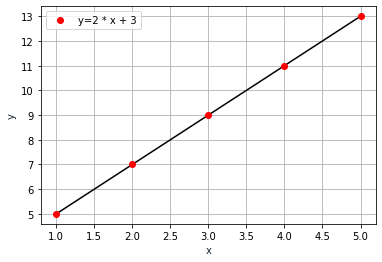

In [212]:
# plot data with axis labels
x = np.linspace(1,5,5)
plt.plot(x, dgp(x), 'r', color='black')
plt.plot(x, dgp(x), 'o', label='y=2 * x + 3',color='red')

plt.xlabel('x', color='#1C2833')
plt.ylabel('y', color='#1C2833')
plt.legend(loc='upper left')
plt.grid()
plt.show()



### Use the sample mean to make a _very_ simple prediction...

The most basic "model" is just to predict the mean of Y. 

**PROBLEM**: Calculate and report the mean of the outcome variable `y`?

In [177]:
# compute the mean manually


(5+7+9+11+13)/5


9.0

In [180]:
# now use a function from the numpy package to calculate the mean


np.mean(y)


9.0

**PROBLEM**: Plot our data as red dots, _overlay_ a plot of the DGP as a black line, and overlay a horizontal line at the mean of Y 

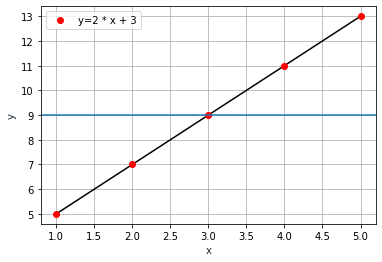

In [217]:
# plot mean prediction


x = np.linspace(1,5,5)

plt.plot(x, dgp(x), 'r', color='black')
plt.plot(x, dgp(x), 'o', label='y=2 * x + 3',color='red')
plt.axhline(np.mean(y))
plt.xlabel('x', color='#1C2833')
plt.ylabel('y', color='#1C2833')
plt.legend(loc='upper left')
plt.grid()
plt.show()


**PROBLEM**: How well does the mean fit our DGP?

In [187]:
#bad, mse:
np.sum(y-np.mean(y)*5)/5

-36.0

### Fit a simple linear regression

You will now try to estimate the coefficients for the `m` and `b` parameters you see in the DGP.  

**PROBLEM**: Prepare to do a linear regression to `X` and `y`.

Let's convert all data into arrays (as defined by the numpy package) so that we know it is valid for numerical computation.

In [202]:
# First, you need to reshape the X data into a "Design Matrix" (a two-dimensional shape)
#  use the reshape() method of the array class of the numpy package
#  your desing matrix with have multiple rows of observations, 
#     but only 1 column as there is one predictor



X=np.arange(1,6).reshape((5,1))

In [203]:
X

array([[1],
       [2],
       [3],
       [4],
       [5]])

In [205]:
# Second, also covert your y data into a numpy array 
#   hint: no need to change the shape - a simple 1-dimensional array (the default) is fine


y=dgp(x)
y.

array([ 5.,  7.,  9., 11., 13.])

**PROBLEM**: Fit a linear regression for `y` and `X`

In [206]:
# fit a linear regression using the LinearRegression() model from sklearn


lr=LinearRegression()
lr.fit(X,y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

**PROBLEM**: Find and report the r-squared, coefficient m, and intercept for the model.

In [210]:
# evaluate the fit in terms of R^2 (i.e. variance explained)
lr.score(X,y)



1.0

In [207]:
# estimate coefficient m


lr.coef_

array([2.])

In [211]:
# estimate intercept b


lr.intercept_

2.9999999999999982

**PROBLEM**: Use the fitted regression model to calculate the predicted value of `y` at `x = 6`.

In [224]:
# use fitted model to predict y at x = 6

lr.predict(np.array([[6]]))



array([15.])

**PROBLEM**: Show (by manual calculation) that the predicted value above matches the true DGP.

In [225]:
2*6+3

15

# PART 4: A SIMPLE CLASSIFICATION PROBLEM

We will now consider some data that will be generated by a *nonlinear* and *noisy* DGP. We want to predict two classes, where `y` equals `1` or `0`, that depend only on the value of `x`. 

Think back to the Credit Default demo. In this example, `y` stands for defaulting and `x` might stand for your amount of debt. For this simple scenario, the more debt you have, the more likely you are to default. We would like predictions to lie in the continuous inerval `[0,1]`.

In [68]:
# generate random samples with seed = 0 and look at the first 10 values of X

np.random.seed(0)
n_samples = 100

X = np.random.normal(size = n_samples)
X[:10]  # inspect the first 10 observations

array([ 1.76405235,  0.40015721,  0.97873798,  2.2408932 ,  1.86755799,
       -0.97727788,  0.95008842, -0.15135721, -0.10321885,  0.4105985 ])

For all values `X > 0`, we will set `y` equal to `1` and `0` otherwise. Add some random noise to `X`. 

In [69]:
# set y to 1 if X > 0

y = X > 0               # Hint: this creates a y array of True and False
y = y.astype(np.float)  # Hint: this converts booleans to 1.0 if try, and 0.0 if False
y[:10]                  # look at the first 10 entries of y

array([1., 1., 1., 1., 1., 0., 1., 0., 0., 1.])

In [70]:
# add some Gaussian noise around the transition point of x = 0 

X = X + 0.2 * np.random.normal(size = n_samples)
X[:10]   # inspect first 10 entries of X

array([ 2.14068249,  0.1306054 ,  0.72464098,  2.43477254,  1.63293331,
       -0.58855364,  0.86736462, -0.30084817,  0.28136955,  0.70670146])

### Plot the data

Simply plot the data - plotting the data is key before fitting any statistical model. 

**PROBLEM**: Plot `X` and `y` on a scatterplot. Will a linear classifier fit these data well?

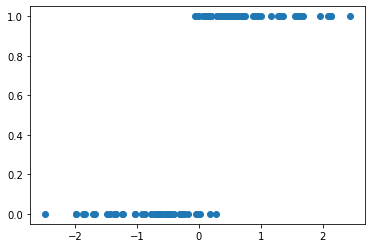

In [71]:
# scatterplot with axis labels



plt.scatter(X,y)
# linear classifier fit these data not well

### Fit a linear probability model

In this part, we simply plot the data. Plotting the data is key before fitting any statistical model. 

**PROBLEM**: Fit a linear regression and look at the intercept. Does the intercept have a reasonable values? Why not?

In [73]:
# fit the linear regression (hint: call .reshape(-1, 1) on X to tell NumPy that there's only one predictor )


X=X.reshape(-1,1)
lr2=LinearRegression()
lr2.fit(X,y)


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [74]:
lr2.intercept_
#yes, because the probability is almost 50%

0.5216114089967183

**PROBLEM**: Plot the linear regression fit.

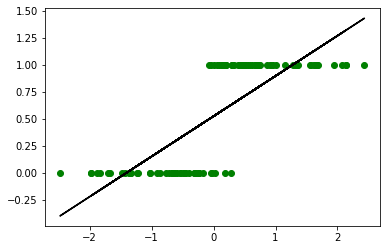

In [75]:
# plot linear regression fit

plt.scatter(X, y,color='g')
plt.plot(X, lr2.predict(X),color='k')

plt.show()


**PROBLEM**: What can you say about predictions for very small/large `x`?

In [ ]:
#they are the same bad: 
#prediction for large negative and large positive doesn't make sense:
#for large negative x: y<0
#for large positive value: y>1
#for small x: 0<=y<=1 but predictions doesn't fit well also.  We could assign y: if y<0.5-> y=0 and if> 0.5 ->y=1

### Now fit a sigmoidal logit model, which may better fit the data.

Remember that for historical reasons, this is called "logistic regression" -- but it is for classification, not regression.

**PROBLEM**: Fit a logit model. 

In [111]:
# fit the logistic regression

logit=LogisticRegression(random_state=0)
logit.fit(X,y)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=0, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

**PROBLEM**: Plot the fitted function. Hint: apply the expit() function to your prediction. This will convert the predictions to an inverse sigmoid shape. How does this model fit the data?

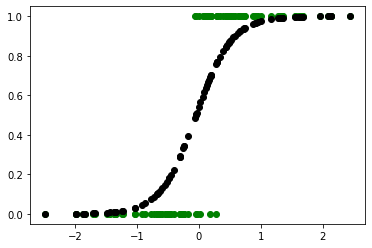

In [112]:
# plot linear regression fit
from scipy.special import expit
plt.scatter(X, y,color='g')
plt.scatter(X, expit(X*logit.coef_ + logit.intercept_),color='k')
plt.show()

In [113]:
# the model fit data well with mean accuracy 0.94
logit.score(X, y)

0.94

# Part 5: Examine Empirical Distributions 

In this section we have already drawn three samples from three different distributions. These appear in the `data/` directory as the files: `data1.txt`, `data2.txt`, `data3.txt`  

You do not know the true distributions from which these samples were drawn - but you can investigate them and try to guess...

### Helper Functions

**PROBLEM**: Define a function to load a list of numbers from a text file.

In [117]:
from numpy import loadtxt
def load_numbers(file):
    data_folder='Data/'
    data=loadtxt(data_folder+file, delimiter=",")
    return data



In [118]:
#example
load_numbers('data1.txt')

array([3.9137118 , 4.16841416, 7.46808521, ..., 4.3671073 , 2.54428026,
       4.68729191])

**PROBLEM**: Define a function to plot a histogram for some data.  

In [119]:
def plot_hist(data):
    bins=200
    plt.hist(data,bins=bins)
    plt.show()

### Distribution 1

**PROBLEM**: Using your functions above, plot a histogram of `data1.txt`

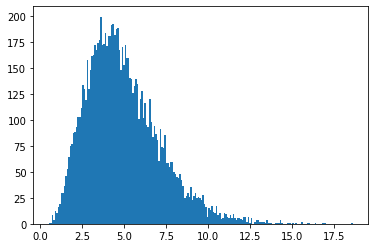

In [317]:

plot_hist(load_numbers('data1.txt'))


**PROBLEM**: Using your functions above, plot a histogram of the logged values of `data1.txt`

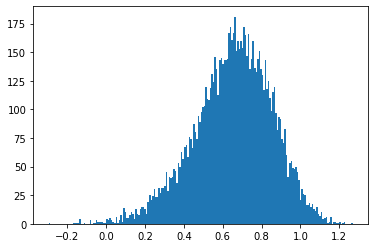

In [318]:

plot_hist(np.log10(load_numbers('data1.txt')))


### Distribution 2

**PROBLEM**: Using your functions above, plot a histogram of `data2.txt`

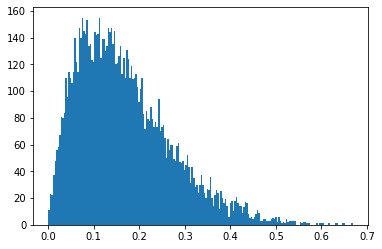

In [319]:

plot_hist(load_numbers('data2.txt'))



**PROBLEM**: Using your functions above, plot a histogram of the logged values of `data2.txt`

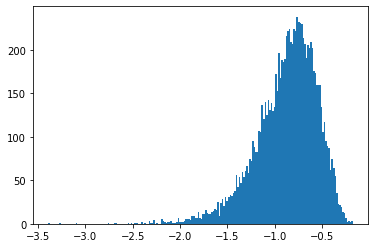

In [320]:


plot_hist(np.log10(load_numbers('data2.txt')))



### Distribution 3

**PROBLEM**: Using your functions above, plot a histogram of `data3.txt`

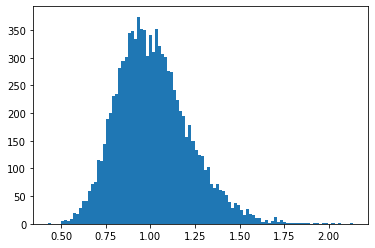

In [296]:

plot_hist(load_numbers('data3.txt'))





**PROBLEM**: Using your functions above, plot a histogram of the logged values of `data3.txt`

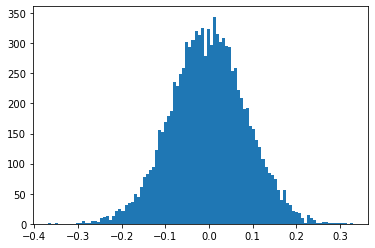

In [308]:


plot_hist(np.log10(load_numbers('data3.txt')))




### Make educated guesses about the distributions

Do some self-directed research to learn about different types of continuous distributions (guassian, gamma, exponential, etc.). Can you identify a distribution that you think could generated each of the three data files you observe above? If so, what kind of distributions? Explain each one for each file.

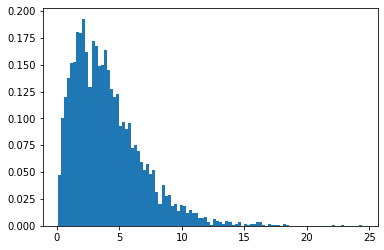

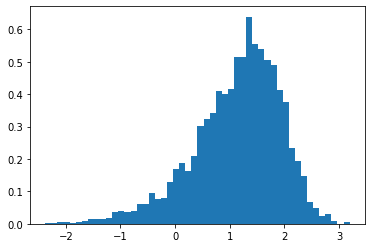

In [366]:
#look at gamma distribution and its log
shape, scale = 2., 2.  # mean=4, std=2*sqrt(2)
s = np.random.gamma(shape, scale, 4000)
import scipy.special as sps  
plt.hist(s,  density=True,bins=100)
plt.show()
plt.hist(np.log(s), 50, density=True)
plt.show()

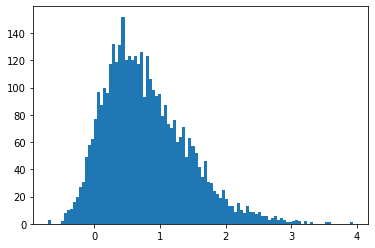

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in log10
  


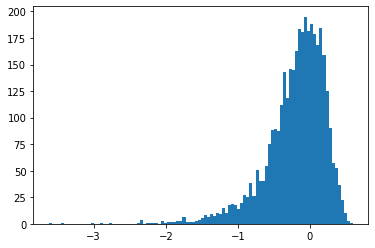

In [365]:
#look at right skewed norm 
from scipy.stats import skewnorm
a = 4
r = skewnorm.rvs(a, size=4000)
plt.hist(r, bins=100)
plt.show()
plt.hist(np.log10(r), bins=100)
plt.show()

In [ ]:
#gamma: mu=a=var
#beta: mu=a/(a+b)


In [120]:
data1=load_numbers('data1.txt')
data2=load_numbers('data2.txt')
data3=load_numbers('data3.txt')


In [121]:
#let's look at statistics of our data
print(np.median(data1),np.mean(data1),np.std(data1),np.var(data1))
print(np.median(data2),np.mean(data2),np.std(data2),np.var(data2))
print(np.median(data3),np.mean(data3),np.std(data3),np.var(data3))

4.629313946750813 4.9758829371888575 2.2122243800797414 4.893936707819195
0.1486442298927952 0.1674197748821542 0.10312394836934585 0.01063454872728351
0.9966095307777191 1.0162703765845162 0.203512512537211 0.04141734275920846


**PROBLEM**: What might be the distribution of `data1.txt`?

mean(data1) is almost equal var(data1), thus
it might be
gamma distribution


**PROBLEM**: What might be the distribution of `data2.txt`?

positively skewed (right) normal

**PROBLEM**: What might be the distribution of `data3.txt`?


lognormal

### Estimate parameters for the distributions

**PROBLEM**: Based on your guess as to the true distribution of the distribution for the `data1.txt` sample, estimate parameters for that distribution.

In [122]:
#gamma.pdf(x, a, loc, scale)
import scipy.stats
dist = getattr(scipy.stats, 'gamma')
param = dist.fit(data1)
print(param)

(4.806326226036164, 0.13107019942532222, 1.0080064278223309)


In [ ]:
#it is similar to gamma distibution because a=4.8~median=4,63 and std=2.21=a**(1/2)=2.2

Details about data1

In [ ]:
#Let's look at data1 precisely 

In [486]:
# does the data come from a normal distrbution?

from statsmodels.stats import diagnostic
diagnostic.kstest_normal(data1, dist = 'norm')

/opt/anaconda3/lib/python3.7/site-packages/statsmodels/stats/_lilliefors.py:272: FutureWarning: The default pvalmethod will change from "approx" to "table" after 0.11. The "table" method uses values from a very large simulation and is more accurate.  Explicitly set this parameter to "approx" or "table" to silence this warning
  warnings.warn(msg, FutureWarning)


(0.0643267769361035, 9.363734459045867e-111)

In [377]:
#p_value < 0.05 -> we can reject the null hypothesis that the data comes from a normal distribution

In [379]:
# does the data come from exp distrbution?
diagnostic.kstest_normal(data1, dist = 'exp')

(0.2890868065012144, 0.0009999999999998899)

In [380]:
#p < 0.05 -> not exponential either

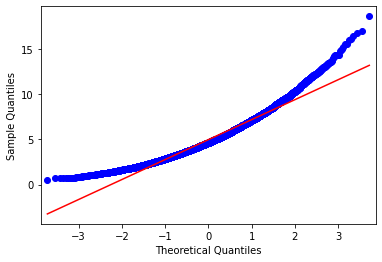

In [413]:
# q-q plot
from statsmodels.graphics.gofplots import qqplot
qqplot(data1,  line='s')
plt.show()

**PROBLEM**: Based on your guess as to the true distribution of the distribution for the `data2.txt` sample, estimate parameters for that distribution.

In [516]:
print(np.median(data2),np.mean(data2),np.std(data2),np.var(data2))


0.1486442298927952 0.1674197748821542 0.10312394836934585 0.01063454872728351


In [498]:

dist2 = getattr(scipy.stats, 'skewnorm')
param2 = dist2.fit(data2)
print(param2)


(8.670626001985823, 0.031046472135349047, 0.17097451021158053)


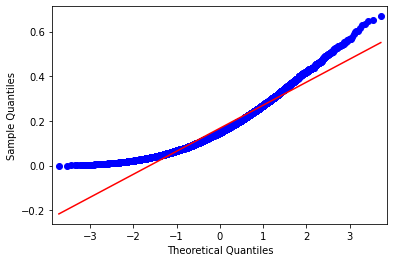

In [412]:
# q-q plot
from statsmodels.graphics.gofplots import qqplot
qqplot(data2,  line='s')
plt.show()

**PROBLEM**: Based on your guess as to the true distribution of the distribution for the `data3.txt` sample, estimate parameters for that distribution.

In [426]:

data3=load_numbers('data3.txt')

dist3 = getattr(scipy.stats, 'lognorm')
param3 = dist.fit(data3)
print(param3)


(2.377962352467291, 0.7961652033664119, 0.29977375103060055)


In [519]:
np.median(data3)

0.9966095307777191

In [525]:
#for lognorm distributiom median=exp(mu) - let's check it
dist3_log = getattr(scipy.stats, 'norm')
param3_log = dist3_log.fit(np.log(data3))
print(param3_log)

(-0.0035248309818158036, 0.19839353981818297)


In [526]:
np.exp(-0.0035)

0.9965061178604149

Details about data 3

In [385]:
diagnostic.kstest_normal(np.log(data3), dist = 'norm')

(0.004915585293481128, 0.7992095109703812)

In [ ]:
#p_value > 0.05 -> we are accepting the null hypothesis that the data comes from a lognormal distribution

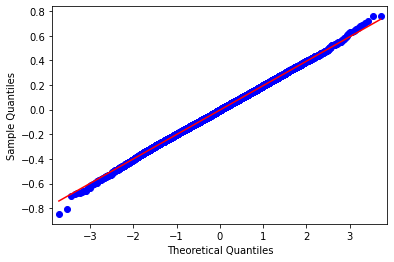

In [395]:
# q-q plot
from statsmodels.graphics.gofplots import qqplot
qqplot(np.log(data3), line='s')
plt.show()

### Comment on your estimated parameters for the above distributions

**PROBLEM**: Will the estimated parameters reported in Question 6 above be the **_True_** population parameters? Why or why not?

data1:gamma with parameters 4.806326226036164, 0.13107019942532222, 1.0080064278223309
data2: positively skewed normal with parameters  (8.670626001985823, 0.031046472135349047, 0.17097451021158053)
data3: lognorm with parameters (2.377962352467291, 0.7961652033664119, 0.29977375103060055)

Yes, for example, salary: incomes are skewed to the right because few millionaireы greatly affect the mean and there are no negative incomes (in that case scale was changed) 



# Part 6: Plot some Theoretical Distributions 

In the previous section, you examined empirical distributions for three files. Now you will plot the theoretical probability density function (pdf) from one particular distribution: the Beta distribution.   

The Beta distribution has two parameters: $\alpha$ and $\beta$).


**PROBLEM**: Plot the **pdf** for a beta distribution with parameters $\alpha = 2$ and $\beta = 5$.

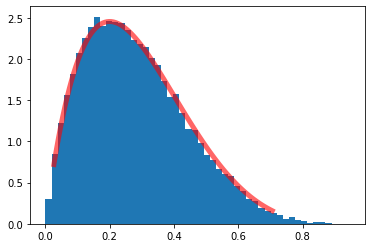

In [3]:
from scipy.stats import beta
a =  2
b = 5

x = np.linspace(beta.ppf(0.01, a, b), beta.ppf(0.99, a, b), 100)
#freeze the distribution 
rv=beta(a,b)
#generate random numbers
r=beta.rvs(a,b,size=15000)
#and display the frozen pdf
plt.plot(x, rv.pdf(x),'r-', lw=5, alpha=0.6, label='beta pdf')
plt.hist(r,density=True,bins=50)

plt.show()

**PROBLEM**: Now plot the same pdf with vertical lines and labels for the lines at the mean, median, and mode of the same distribution as above.

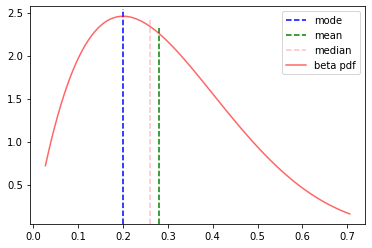

In [46]:
from statistics import mode
import math
m=(a-1)/(a+b-2)
plt.axvline(m,ymin=0, ymax=0.99,ls='--',color='blue',label='mode')
plt.axvline(x=np.mean(r),ymin=0, ymax=0.9,ls='--',color='green',label='mean')
plt.axvline(np.median(r),ymin=0, ymax=0.95,ls='--',color='pink',label='median')


#plt.hist(r,density=True,bins=50)

plt.plot(x, rv.pdf(x),'r-', alpha=0.6, label='beta pdf')
plt.legend()
plt.show()


**PROBLEM**: Comment on why (intuitively) the mean, median and mode are ordered as shown above. 

**PROBLEM**: Comment on the nature of the probability distribution function for the outcome. What's the distribution skew and kurtosis? How can we interpret skewness? Why does skewness matter? What migh be a remedy to "de-skew" data?

In [649]:
# compute skewness and kurtosis to use in your answer

from scipy.stats import kurtosis, skew
skew(r),kurtosis(r)

(0.5999490808969679, -0.11639927813752005)

In [660]:
print(np.median(r))
print(np.mean(r))
print(np.var(r))

0.26304874793830413
0.28486245675353106
0.025885219292682185


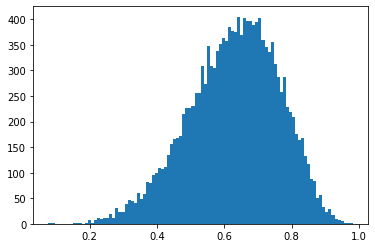

In [163]:
#The best method to deskew- cube root 
def normalize(column):
    upper = column.max()
    lower = column.min()
    y = (column - lower)/(upper-lower)
    return y
#r_deskew =normalize(r)
r_deskew=np.log(r)
r_deskew2=np.log(r+1)
r_deskew3=normalize(np.log10(r+1))
r_deskew4=r**(1/3)
plt.hist(r_deskew4,bins=100)
plt.show()

# Part 7: Exploratory Data Analysis 

In this part of the assignment you explore credit card data from a Taiwanese bank. A credit card default happens when a customer fails to pay the minimum due on a credit card bill for more than 6 months. We are providing you with a dataset from a Taiwanese bank with 30,000 observations (Source: *Yeh, I. C., & Lien, C. H. (2009). The comparisons of data mining techniques for the predictive accuracy of probability of default of credit card clients. Expert Systems with Applications, 36(2), 2473-2480.*). You can read that article for background information (if you wish). Each observation represents an account at the bank at the end of October 2005.  We renamed the variable default_payment_next_month to customer_default. Eventually, the target variable to predict will be `customer_default` -- i.e., whether the customer will default in the following month (1 = Yes or 0 = No). The dataset also includes 23 other explanatory features. 

Variables are defined as follows:

| Feature name     | Variable Type | Description 
|------------------|---------------|--------------------------------------------------------
| customer_default | Binary        | 1 = default in following month; 0 = no default 
| LIMIT_BAL        | Continuous    | Credit limit   
| SEX              | Categorical   | 1 = male; 2 = female
| EDUCATION        | Categorical   | 1 = graduate school; 2 = university; 3 = high school; 4 = others
| MARRIAGE         | Categorical   | 0 = unknown; 1 = married; 2 = single; 3 = others
| AGE              | Continuous    | Age in years  
| PAY1             | Categorical   | Repayment status in September, 2005 
| PAY2             | Categorical   | Repayment status in August, 2005 
| PAY3             | Categorical   | Repayment status in July, 2005 
| PAY4             | Categorical   | Repayment status in June, 2005 
| PAY5             | Categorical   | Repayment status in May, 2005 
| PAY6             | Categorical   | Repayment status in April, 2005 
| BILL_AMT1        | Continuous    | Balance in September, 2005  
| BILL_AMT2        | Continuous    | Balance in August, 2005  
| BILL_AMT3        | Continuous    | Balance in July, 2005  
| BILL_AMT4        | Continuous    | Balance in June, 2005 
| BILL_AMT5        | Continuous    | Balance in May, 2005  
| BILL_AMT6        | Continuous    | Balance in April, 2005  
| PAY_AMT1         | Continuous    | Amount paid in September, 2005
| PAY_AMT2         | Continuous    | Amount paid in August, 2005
| PAY_AMT3         | Continuous    | Amount paid in July, 2005
| PAY_AMT4         | Continuous    | Amount paid in June, 2005
| PAY_AMT5         | Continuous    | Amount paid in May, 2005
| PAY_AMT6         | Continuous    | Amount paid in April, 2005

The measurement scale for repayment status is:   

    -2 = payment two months in advance   
    -1 = payment one month in advance   
    0 = pay duly   
    1 = payment delay for one month   
    2 = payment delay for two months   
    3 = payment delay for three months   
    4 = payment delay for four months   
    5 = payment delay for five months   
    6 = payment delay for six months   
    7 = payment delay for seven months   
    8 = payment delay for eight months   
    9 = payment delay for nine months or more  

**PROBLEM**: Load the data into a pandas dataframe called `data`, then list out the columns.

In [586]:
# Load data


data=pd.read_csv('data/credit_data.csv')

In [587]:
# View columns


data.columns

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_1',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'customer_default'],
      dtype='object')

**PROBLEM**: Do some exploratory data analysis on the feature EDUCATION. Comment on what you observe. Can you use this variable with no modifications? Why or why not?

In [595]:
# Investigate 'education'


In [594]:
#desciption: 1 = graduate school; 2 = university; 3 = high school; 4 = others
data.EDUCATION.value_counts()

2    14030
1    10585
3     4917
5      280
4      123
6       51
0       14
Name: EDUCATION, dtype: int64

In [ ]:
#I observe more values (like 0,5,6) than in the description, we could use them but we should understand their values

ANSWER: There is a mismatch between the data description and the actual data: there are 14 zero values that theoretically should not be there. 

**PROBLEM**: How many female customers defaulted in the dataset? 

In [602]:

data[(data.SEX==2) & (data.customer_default==1)].shape[0]


3763

ANSWER: 3763

**PROBLEM**: Analyze the MARRIAGE variable by the target variable (customer_default), using g the pandas crosstab() function (this will show totals by level of Marriage. For an excellent answer, also show overall total counts (ignoring customer_default) by level of Marriage.

In [612]:
pd.crosstab(data.customer_default,data.MARRIAGE)


MARRIAGE,0,1,2,3
customer_default,,,,
0,49,10453,12623,239
1,5,3206,3341,84


In [611]:
data.MARRIAGE.value_counts()


2    15964
1    13659
3      323
0       54
Name: MARRIAGE, dtype: int64

**PROBLEM**: What is the data type of all features in this dataframe (as imported by Pandas)?

In [614]:
# Check data types


data.dtypes

ID                  int64
LIMIT_BAL           int64
SEX                 int64
EDUCATION           int64
MARRIAGE            int64
AGE                 int64
PAY_1               int64
PAY_2               int64
PAY_3               int64
PAY_4               int64
PAY_5               int64
PAY_6               int64
BILL_AMT1           int64
BILL_AMT2           int64
BILL_AMT3           int64
BILL_AMT4           int64
BILL_AMT5           int64
BILL_AMT6           int64
PAY_AMT1            int64
PAY_AMT2            int64
PAY_AMT3            int64
PAY_AMT4            int64
PAY_AMT5            int64
PAY_AMT6            int64
customer_default    int64
dtype: object

ANSWER: int64

**PROBLEM**: Plot a "boxplot" of the variable LIMIT_BAL.

<AxesSubplot:xlabel='LIMIT_BAL'>

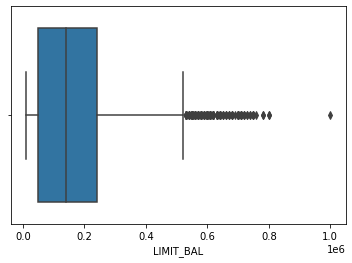

In [616]:
# Check distribution of the Credit Limit using box plot

sns.boxplot(data.LIMIT_BAL)

**PROBLEM**: What is the minimum value of LIMIT_BAL?

In [617]:

np.min(data.LIMIT_BAL)


10000

**PROBLEM**: Install the python package "pandas_profiling" and run an automated "profile_report" on your dataset. HINT: We did not import it for you... you'll need to install and import it yourself

In [621]:
!pip install pandas_profiling



  Using cached certifi-2020.6.20-py2.py3-none-any.whl (156 kB)


  Attempting uninstall: certifi
    Found existing installation: certifi 2019.11.28
    Uninstalling certifi-2019.11.28:
      Successfully uninstalled certifi-2019.11.28


In [624]:
# Run a pandas-Profiling report
from pandas_profiling import ProfileReport
data.profile_report()

**PROBLEM**: One-hot-encode SEX and MARRIAGE

In [626]:
from sklearn.preprocessing import OneHotEncoder
onehot_encoder = OneHotEncoder(sparse=False)
categorical_columns=['SEX','MARRIAGE']
encoded_categorical_columns = pd.DataFrame(onehot_encoder.fit_transform(data[categorical_columns]))




**PROBLEM**: Run some code to prove that SEX and MARRIAGE are now one-hot-encoded and are now binary indicators (also called dummy variables).

In [627]:
# View columns

encoded_categorical_columns.head()


,0,1,2,3,4,5
0,0.0,1.0,0.0,1.0,0.0,0.0
1,0.0,1.0,0.0,0.0,1.0,0.0
2,0.0,1.0,0.0,0.0,1.0,0.0
3,0.0,1.0,0.0,1.0,0.0,0.0
4,1.0,0.0,0.0,1.0,0.0,0.0


In [635]:
encoded_categorical_columns.rename(columns={0:"SEX_0",1:"SEX_1",2:"MARRIAGE_0",3:"MARRIAGE_1",4:"MARRIAGE_2",5:"MARRIAGE_3"},inplace=True)

In [639]:
# Inspect counts for MARRIAGE_0

#encoded_categorical_columns.MARRIAGE_0.sum()
encoded_categorical_columns[encoded_categorical_columns.MARRIAGE_0==1].shape[0]

54

In [640]:
# Inspect counts for MARRIAGE_1


encoded_categorical_columns[encoded_categorical_columns.MARRIAGE_1==1].shape[0]

13659

In [641]:
# Inspect counts for MARRIAGE_2


encoded_categorical_columns[encoded_categorical_columns.MARRIAGE_2==1].shape[0]

15964

In [642]:
# Inspect counts for MARRIAGE_3

encoded_categorical_columns[encoded_categorical_columns.MARRIAGE_3==1].shape[0]


323

# Part 8: Self Directed Learning 

In this final part of the assignment, we would like you to do some self-directed learning on another dataset of your choice. Select an __open__ data repository, select a dataset, download it, and then use combinations of what you have already covered above to explore your data. An open repository is one that we can access as well, without setting up an account. 

#### Important Note:

__Your notebook and code must include a command within it to download your dataset into the working directory.__ 

One way to accomplish the above is to use a notebook "Magic Command" to call a program like `wget` or `curl` to download the data for you. How you accomplish this task is up to you (and learning the solution is part of the assignment); but in any case, you notebook must be able to _run from the top_ (i.e., we can simply start to execute from the top of the notebook, and everything will run correctly). Be sure to test that yourself before you submit. 

In [644]:
!pip install wget

  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=11570 sha256=666556c11ccf076224ecab294c225541507c97ad1a369da61b4ff1aa00558ffa
  Stored in directory: /Users/ekaterinakryukova/Library/Caches/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built wget


In [170]:
import wget 
wget.download("https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/archived_data/archived_time_series/time_series_19-covid-Confirmed_archived_0325.csv",
              "covid.csv")

'covid.csv'

In [171]:
covid=pd.read_csv("covid.csv")

In [172]:
covid.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20
0,NaN,Thailand,15.0000,101.0000,2,3,5,7,8,8,...,82,114,147,177,212,272,322,411,599,599.0
1,NaN,Japan,36.0000,138.0000,2,1,2,2,4,4,...,773,839,825,878,889,924,963,1007,1086,1086.0
2,NaN,Singapore,1.2833,103.8333,0,1,3,3,4,5,...,212,226,243,266,313,345,385,432,455,455.0
3,NaN,Nepal,28.1667,84.2500,0,0,0,1,1,1,...,1,1,1,1,1,1,1,1,2,2.0
4,NaN,Malaysia,2.5000,112.5000,0,0,0,3,4,4,...,238,428,566,673,790,900,1030,1183,1306,1306.0


In [174]:
covid.shape

(501, 66)

In [173]:
covid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 501 entries, 0 to 500
Data columns (total 66 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Province/State  327 non-null    object 
 1   Country/Region  501 non-null    object 
 2   Lat             501 non-null    float64
 3   Long            501 non-null    float64
 4   1/22/20         501 non-null    int64  
 5   1/23/20         501 non-null    int64  
 6   1/24/20         501 non-null    int64  
 7   1/25/20         501 non-null    int64  
 8   1/26/20         501 non-null    int64  
 9   1/27/20         501 non-null    int64  
 10  1/28/20         501 non-null    int64  
 11  1/29/20         501 non-null    int64  
 12  1/30/20         501 non-null    int64  
 13  1/31/20         501 non-null    int64  
 14  2/1/20          501 non-null    int64  
 15  2/2/20          501 non-null    int64  
 16  2/3/20          501 non-null    int64  
 17  2/4/20          501 non-null    int

In [ ]:
#We have data with for the COVID-19 confirmed case reports from 1/22/20  to 3/23/20  
#We have 501 rows
# 174 rows of Province/State are null

In [176]:
covid.describe()

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,...,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20
count,501.000000,501.000000,501.000000,501.000000,501.000000,501.000000,501.000000,501.000000,501.000000,501.000000,...,501.000000,501.000000,501.000000,501.000000,501.000000,501.000000,501.000000,501.000000,501.000000,309.000000
mean,30.285772,-33.097762,1.107784,1.303393,1.878244,2.862275,4.227545,5.842315,11.133733,12.307385,...,311.564870,334.223553,362.329341,393.497006,428.962076,484.447106,543.245509,607.832335,670.568862,1087.391586
std,19.870544,80.661210,19.886889,19.969170,24.875593,34.637942,48.422475,65.253024,159.914427,160.961540,...,3263.324717,3332.995975,3415.516311,3511.636870,3642.374951,3832.930820,4064.084657,4337.179809,4594.278660,5814.685942
min,-41.454500,-157.858400,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,23.341700,-90.230800,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,10.000000
50%,37.251900,-73.182200,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,1.000000,1.000000,1.000000,1.000000,2.000000,2.000000,3.000000,3.000000,76.000000
75%,42.165700,21.824300,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,22.000000,28.000000,37.000000,50.000000,58.000000,76.000000,89.000000,117.000000,135.000000,326.000000
max,72.000000,178.065000,444.000000,444.000000,549.000000,761.000000,1058.000000,1423.000000,3554.000000,3554.000000,...,67790.000000,67794.000000,67798.000000,67799.000000,67800.000000,67800.000000,67800.000000,67800.000000,67800.000000,67800.000000


In [180]:
covid["Province/State"].value_counts()

Grand Princess           2
Diamond Princess         2
Chongqing                1
Rockingham County, NH    1
Summit, UT               1
                        ..
Norfolk, VA              1
Arizona                  1
Montana                  1
Gunnison, CO             1
Jiangsu                  1
Name: Province/State, Length: 325, dtype: int64

In [181]:
#What is the most common Country/Region we have in data? -US
covid["Country/Region"].value_counts()

US            249
China          33
Canada         12
Australia       9
France          9
             ... 
San Marino      1
Mauritania      1
Lithuania       1
Mayotte         1
Moldova         1
Name: Country/Region, Length: 183, dtype: int64

In [187]:
#Let's look at the sum of this period
covid['sum_for_a_region']=covid.iloc[:,4:].sum(axis=1)
covid.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,sum_for_a_region
0,NaN,Thailand,15.0000,101.0000,2,3,5,7,8,8,...,114,147,177,212,272,322,411,599,599.0,9268.0
1,NaN,Japan,36.0000,138.0000,2,1,2,2,4,4,...,839,825,878,889,924,963,1007,1086,1086.0,35300.0
2,NaN,Singapore,1.2833,103.8333,0,1,3,3,4,5,...,226,243,266,313,345,385,432,455,455.0,14030.0
3,NaN,Nepal,28.1667,84.2500,0,0,0,1,1,1,...,1,1,1,1,1,1,1,2,2.0,122.0
4,NaN,Malaysia,2.5000,112.5000,0,0,0,3,4,4,...,428,566,673,790,900,1030,1183,1306,1306.0,20394.0


In [233]:
#Let's look at numner of cases of each Country/Region  
covid.groupby('Country/Region')[['Country/Region','sum_for_a_region']].sum().sort_values(by='sum_for_a_region',ascending=False)

,sum_for_a_region
Country/Region,
China,7062338.0
Italy,995918.0
Iran,505540.0
Spain,372400.0
"Korea, South",363398.0
...,...
Republic of the Congo,0.0
Puerto Rico,0.0
Guernsey,0.0


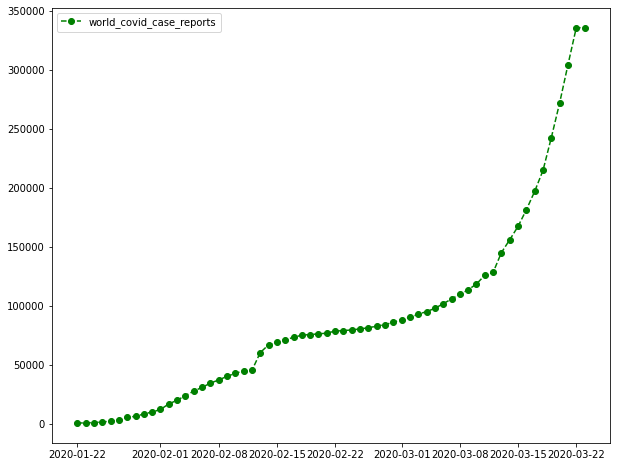

In [250]:
#let's plot sum for each day
plt.figure(figsize=(10, 8))

plt.plot(pd.to_datetime(covid.columns[4:-1]),covid.iloc[:,4:66].sum(axis=0),'go--',label='world_covid_case_reports',color='green')
plt.legend()

plt.show()

In [253]:
covid_region_case=covid.groupby("Country/Region").sum().drop(['Lat','Long'],axis=1).reset_index()

In [254]:
covid_region_case.head()

,Country/Region,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,sum_for_a_region
0,Afghanistan,0,0,0,0,0,0,0,0,0,...,16,21,22,22,22,24,24,40,40.0,578.0
1,Albania,0,0,0,0,0,0,0,0,0,...,42,51,55,59,64,70,76,89,89.0,1426.0
2,Algeria,0,0,0,0,0,0,0,0,0,...,48,54,60,74,87,90,139,201,201.0,2384.0
3,Andorra,0,0,0,0,0,0,0,0,0,...,1,2,39,39,53,75,88,113,113.0,1072.0
4,Angola,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,2,2,2.0,14.0


In [255]:
covid_region_case.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183 entries, 0 to 182
Data columns (total 64 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Country/Region    183 non-null    object 
 1   1/22/20           183 non-null    int64  
 2   1/23/20           183 non-null    int64  
 3   1/24/20           183 non-null    int64  
 4   1/25/20           183 non-null    int64  
 5   1/26/20           183 non-null    int64  
 6   1/27/20           183 non-null    int64  
 7   1/28/20           183 non-null    int64  
 8   1/29/20           183 non-null    int64  
 9   1/30/20           183 non-null    int64  
 10  1/31/20           183 non-null    int64  
 11  2/1/20            183 non-null    int64  
 12  2/2/20            183 non-null    int64  
 13  2/3/20            183 non-null    int64  
 14  2/4/20            183 non-null    int64  
 15  2/5/20            183 non-null    int64  
 16  2/6/20            183 non-null    int64  
 1

In [256]:
covid_region_case[['Country/Region','sum_for_a_region']].sort_values(by='sum_for_a_region',ascending=False)

,Country/Region,sum_for_a_region
33,China,7062338.0
86,Italy,995918.0
82,Iran,505540.0
155,Spain,372400.0
93,"Korea, South",363398.0
...,...,...
138,Republic of the Congo,0.0
136,Puerto Rico,0.0
72,Guernsey,0.0
67,Greenland,0.0


In [257]:
#let's look at china's reports
covid_region_case[covid_region_case['Country/Region']=='China'].iloc[:,1:63]

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20
33,548,643,920,1406,2075,2877,5509,6087,8141,9802,...,80977,81003,81033,81058,81102,81156,81250,81305,81397,81439.0


In [265]:
covid_region_case[covid_region_case['Country/Region']=='China'].iloc[:,1:63].columns

Index(['1/22/20', '1/23/20', '1/24/20', '1/25/20', '1/26/20', '1/27/20',
       '1/28/20', '1/29/20', '1/30/20', '1/31/20', '2/1/20', '2/2/20',
       '2/3/20', '2/4/20', '2/5/20', '2/6/20', '2/7/20', '2/8/20', '2/9/20',
       '2/10/20', '2/11/20', '2/12/20', '2/13/20', '2/14/20', '2/15/20',
       '2/16/20', '2/17/20', '2/18/20', '2/19/20', '2/20/20', '2/21/20',
       '2/22/20', '2/23/20', '2/24/20', '2/25/20', '2/26/20', '2/27/20',
       '2/28/20', '2/29/20', '3/1/20', '3/2/20', '3/3/20', '3/4/20', '3/5/20',
       '3/6/20', '3/7/20', '3/8/20', '3/9/20', '3/10/20', '3/11/20', '3/12/20',
       '3/13/20', '3/14/20', '3/15/20', '3/16/20', '3/17/20', '3/18/20',
       '3/19/20', '3/20/20', '3/21/20', '3/22/20', '3/23/20'],
      dtype='object')

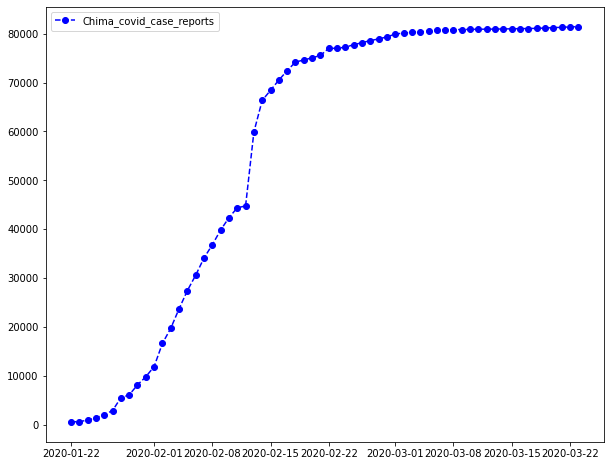

In [270]:
plt.figure(figsize=(10, 8))
plt.plot(pd.to_datetime(covid_region_case[covid_region_case['Country/Region']=='China'].iloc[:,1:63].columns),
         covid_region_case[covid_region_case['Country/Region']=='China'].iloc[:,1:63].values[0],
         'go--',label='Chima_covid_case_reports',color='blue')
plt.legend()
plt.show()

In [2]:
#While I was doing this task I was flighting to Palermo and I was afraid of having a crash
#Thus, I would like also to look at statistics of Aircraft-Accidents

In [34]:
import wget 
wget.download("https://raw.githubusercontent.com/RohitLearner/Flight-Crash-Investigation/master/input/Airplane_Crashes_and_Fatalities_Since_1908.csv",
              "aircraft_crashes2.csv")

'aircraft_crashes2.csv'

In [35]:
import chardet
import pandas as pd

with open('aircraft_crashes2.csv', 'rb') as f:
    result = chardet.detect(f.read())
aircraft_crashes=pd.read_csv('aircraft_crashes.csv',header=None,sep='\t',error_bad_lines=False, encoding=result['encoding'])

In [36]:
aircraft_crashes

,0,1,2,3
0,"Gor?, Ethiopia",8.15,35.53333,success
1,"Pastaza, Ecuador",-1.795993,-76.766887,doubt
2,"Quang Ngai, Vietnam",15.008864,108.644286,doubt
3,"Montserrat, Beverly, MA, USA",42.563587,-70.873187,success
4,"Santiago, Chile",-33.428532,-70.630133,success
...,...,...,...,...
1993,"Near Taisha, Ecuador",?,?,?
1994,"Puerto Williams, Chile",?,?,?
1995,"Near Colorado Springs, Colorado",?,?,?
1996,"La Puerta, Venezuela",?,?,?


In [30]:
aircraft_crashes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1998 entries, 0 to 1997
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       1998 non-null   object
 1   1       1998 non-null   object
 2   2       1998 non-null   object
 3   3       1998 non-null   object
dtypes: object(4)
memory usage: 62.6+ KB


In [31]:
aircraft_crashes.shape

(1998, 4)

In [32]:
aircraft_crashes.dtypes

0    object
1    object
2    object
3    object
dtype: object